# ESRA

## E-Survey of Road users' Attitudes

publication: https://www.vias.be/publications/ESRA%202%20A%20global%20look%20at%20road%20safety/A%20global%20look%20at%20road%20safety%20-%20Synthesis%20from%20the%20ESRA2%20survey%20in%2048%20countries.pdf

dashboard: https://app.powerbi.com/view?r=eyJrIjoiM2Y5MzEwYTMtMTE1Mi00MzNkLWFlOWQtNmU2ZWNiM2RhYzJlIiwidCI6IjlkMWIxYjIyLWE5ZTAtNDg1Mi1hMTEwLWZlYzRmZDc1N2M2ZSIsImMiOjh9&pageName=ReportSection9fbd3f40b24badccab99

In [21]:
import pandas as pd
import sys
import os
import geopandas as gpd
import matplotlib.pyplot as plt

In [2]:
file = "esra.xlsx"

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253.0,Africa,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
...,...,...,...,...,...,...
172,6944975.0,Europe,Serbia,SRB,51475,"POLYGON ((18.82982 45.90887, 18.82984 45.90888..."
173,622137.0,Europe,Montenegro,MNE,5542,"POLYGON ((20.07070 42.58863, 19.80161 42.50009..."
174,1794248.0,Europe,Kosovo,-99,7926,"POLYGON ((20.59025 41.85541, 20.52295 42.21787..."
175,1394973.0,North America,Trinidad and Tobago,TTO,24269,"POLYGON ((-61.68000 10.76000, -61.10500 10.890..."


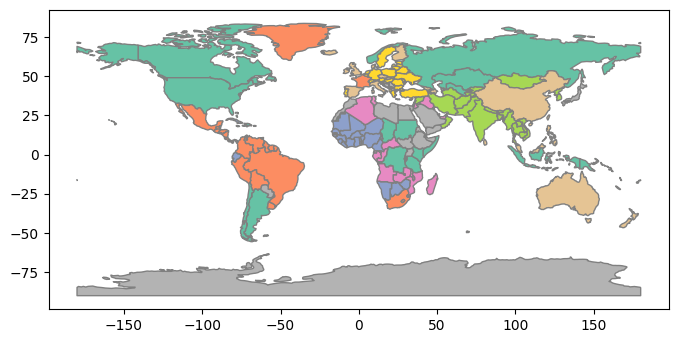

In [27]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
ax2 = world.plot( figsize=(8,4), edgecolor=u'gray', cmap='Set2' )
world


In [85]:
def plot_map(col, data, free_legend=False, lower=0.0, higher=1.0):
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
    #ax2 = world.plot( figsize=(8,4), edgecolor=u'gray', cmap='Set2' )

    merge_df = pd.merge(left=world, right=data, how="left", left_on="name", right_on="Country")

    vmin = lower#data[col].min()
    vmax = higher#data[col].max()
    cmap = "viridis"

    fig, ax = plt.subplots(1, figsize=(20, 8))
    ax.axis('off')
    if not free_legend:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend, vmin=lower, vmax=higher)
    else:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend)
    world.boundary.plot(ax=ax, linewidth=0.4, edgecolor=u'gray')

    ax.set_title(col, fontdict={'fontsize': '25', 'fontweight': '3'})

    if not free_legend:
        # Create colorbar as a legend
        sm = plt.cm.ScalarMappable(norm=plt.Normalize(vmin=vmin, vmax=vmax), cmap=cmap)
        # Empty array for the data range
        sm._A = []
        # Add the colorbar to the figure
        cbaxes = fig.add_axes([0.15, 0.25, 0.01, 0.4])
        cbar = fig.colorbar(sm, cax=cbaxes)

    plt.plot()

### Use of transport modes – a few days a month (Q10)
Table 5: Use of transport modes, by country and region (% at least a few days a month).

In [112]:
data = pd.read_excel(file,sheet_name=0)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    data[col] = data[col].str.rstrip("%").astype(float)/100
data.to_csv('csv/transport_modes_month.csv')
data

,Country,Pedestrian,Cyclist,Moped rider /motorcyclist,Car as driver,Car as a passenger,Public transport
0,Australia,0.889,0.209,0.076,0.804,0.722,0.456
1,Austria,0.976,0.491,0.122,0.490,0.371,0.332
2,Belgium,0.902,0.403,0.106,0.772,0.628,0.422
3,Benin,0.946,0.285,0.632,0.318,0.769,0.426
4,Bulgaria,0.909,0.414,0.151,0.683,0.821,0.670
5,Cameroon,0.956,0.255,0.618,0.431,0.990,0.637
6,Canada,0.829,0.284,0.095,0.773,0.713,0.380
7,Colombia,0.929,0.585,0.357,0.558,0.885,0.831
8,Czech Republic,0.928,0.349,0.107,0.606,0.660,0.641
9,Denmark,0.946,0.566,0.083,0.743,0.788,0.503


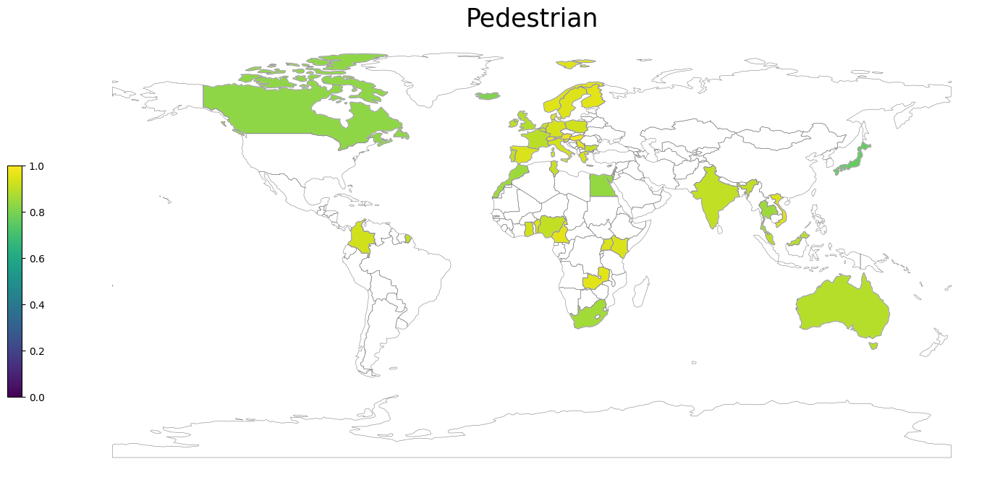

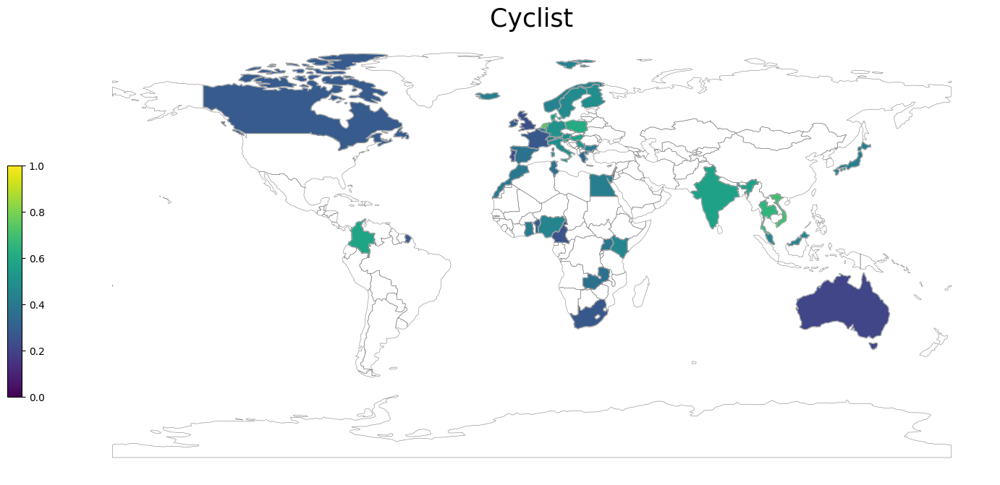

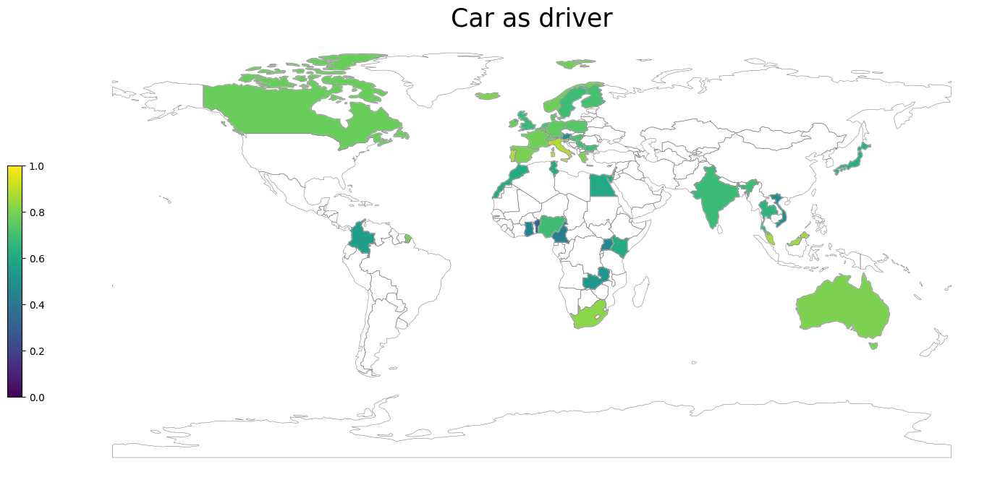

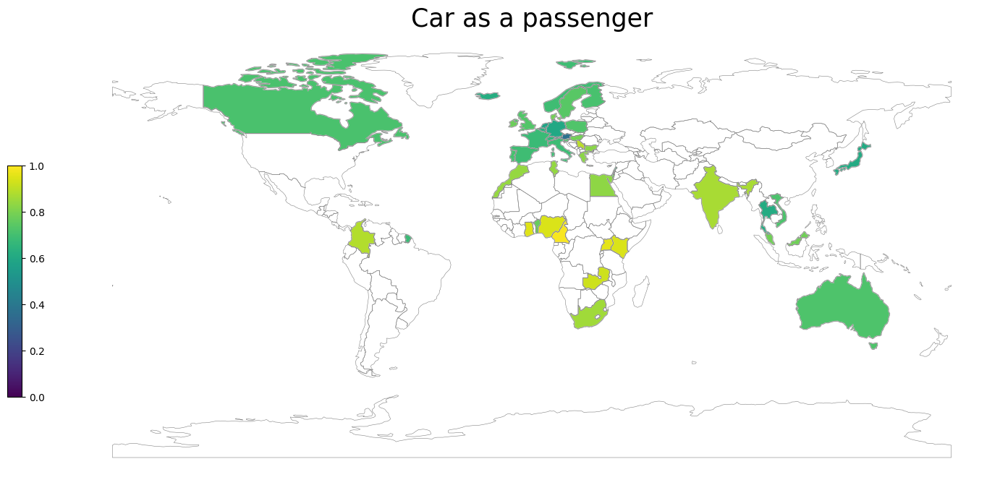

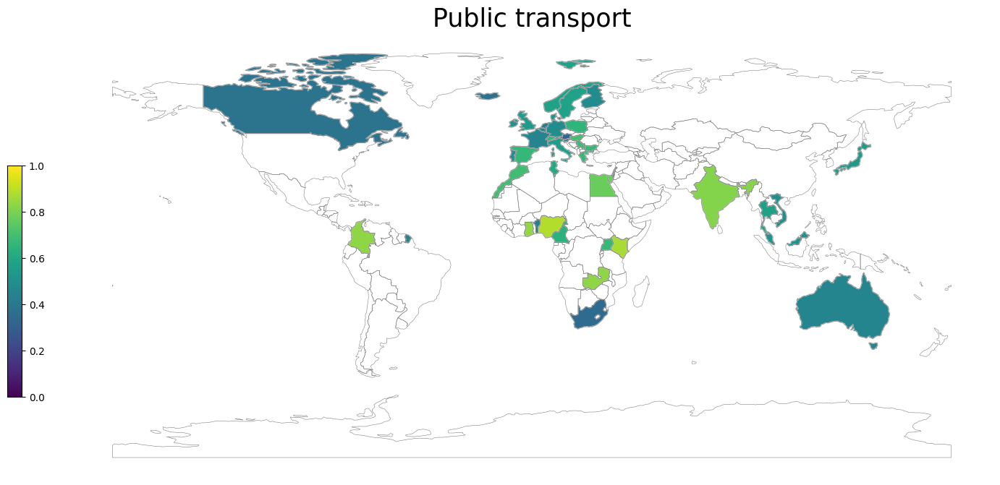

In [113]:
plot_map("Pedestrian", data)
plot_map("Cyclist", data)
plot_map("Car as driver", data)
plot_map("Car as a passenger", data)
plot_map("Public transport", data)

### Use of transport modes – a few days a year (Q10)
Table 6: Use of transport modes, by country and region (% at least a few days a year).

In [6]:
data = pd.read_excel(file,sheet_name=1)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    data[col] = data[col].str.rstrip("%").astype(float)/100
data.to_csv('csv/transport_modes_year.csv')
data

,Country,Pedestrian,Cyclist,Moped rider /motorcyclist,Car as driver,Car as a passenger,Public transport
0,Australia,0.938,0.331,0.112,0.836,0.925,0.813
1,Austria,0.993,0.700,0.212,0.576,0.614,0.610
2,Belgium,0.942,0.575,0.157,0.801,0.878,0.809
3,Benin,0.971,0.521,0.731,0.426,0.975,0.839
4,Bulgaria,0.938,0.643,0.280,0.744,0.975,0.963
5,Cameroon,0.985,0.441,0.657,0.539,0.995,0.922
6,Canada,0.896,0.497,0.139,0.807,0.939,0.772
7,Colombia,0.956,0.754,0.454,0.626,0.983,0.982
8,Czech Republic,0.975,0.600,0.245,0.688,0.967,0.964
9,Denmark,0.966,0.740,0.170,0.800,0.970,0.890


### Self-declared behaviour as car driver and car passenger (Q12_1b/Q12_2)
Table 7: Self-declared behaviour as a car driver/passenger, by country and region (% at least once in the past 30 days – scores 2 to 5 on a 5-point scale from
1 “never” to 5 “[almost] always”).

In [53]:
data = pd.read_excel(file,sheet_name=2)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/self_declared_behaviour_driver_passenger.csv')
data

,Country,drive when you may have been over the legal limit for drinking and driving,drive after drinking alcohol,drive 1 hour after using drugs (other than medication ),drive after taking medication that carries a warning that it may influence your driving ability,drive faster than the speed limit inside built-up areas,drive faster than the speed limit outside built-up areas (but not on motorways /freeways),drive faster than the speed limit on motorways /freeways,drive without wearing your seatbelt,transport children under 150cm* without using child restraint systems,transport children over 150cm* without wearing their seatbelts,as a car passenger travel without wearing your seatbelt in the back seat,talk on a hand-held mobile phone while driving,talk on a hands-free mobile phone while driving,read a text message/e mail or check social media while driving,drive when you were so sleepy that you had trouble keeping your eyes open
0,Australia,0.089,0.237,0.059,0.134,0.446,0.506,0.493,0.063,0.079,0.059,0.1,0.125,0.413,0.19,0.17
1,Austria,0.148,0.305,0.073,0.22,0.714,0.825,0.77,0.199,0.148,0.098,0.437,0.365,0.636,0.342,0.318
2,Belgium,0.242,0.331,0.071,0.181,0.617,0.721,0.683,0.142,0.144,0.12,0.301,0.222,0.455,0.281,0.244
3,Benin,0.247,0.377,0.195,0.221,0.312,0.558,0.416,0.364,0.579,0.6,0.694,0.481,0.701,0.221,0.143
4,Bulgaria,0.051,0.093,0.035,0.101,0.491,0.552,0.44,0.337,0.19,0.216,0.58,0.385,0.522,0.249,0.193
5,Cameroon,0.239,0.27,0.09,0.159,0.398,0.472,0.443,0.614,0.545,0.556,0.866,0.364,0.625,0.33,0.091
6,Canada,0.145,0.259,0.128,0.167,0.664,0.751,0.786,0.16,0.199,0.155,0.252,0.214,0.436,0.26,0.22
7,Colombia,0.11,0.136,0.044,0.102,0.387,0.481,0.489,0.204,0.33,0.232,0.767,0.361,0.674,0.416,0.178
8,Czech Republic,0.119,0.072,0.027,0.115,0.683,0.783,0.711,0.277,0.152,0.117,0.493,0.337,0.406,0.268,0.219
9,Denmark,0.116,0.267,0.042,0.122,0.618,0.818,0.741,0.129,0.308,0.09,0.202,0.244,0.421,0.29,0.241


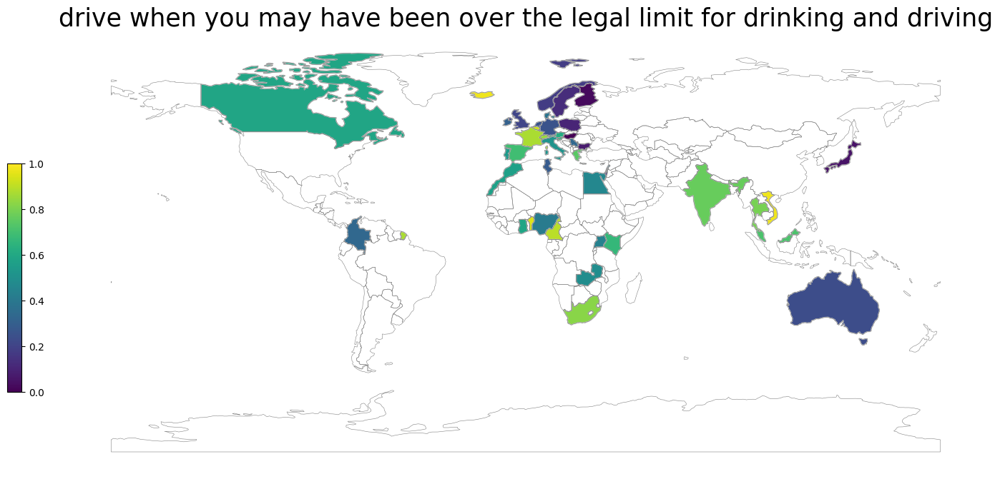

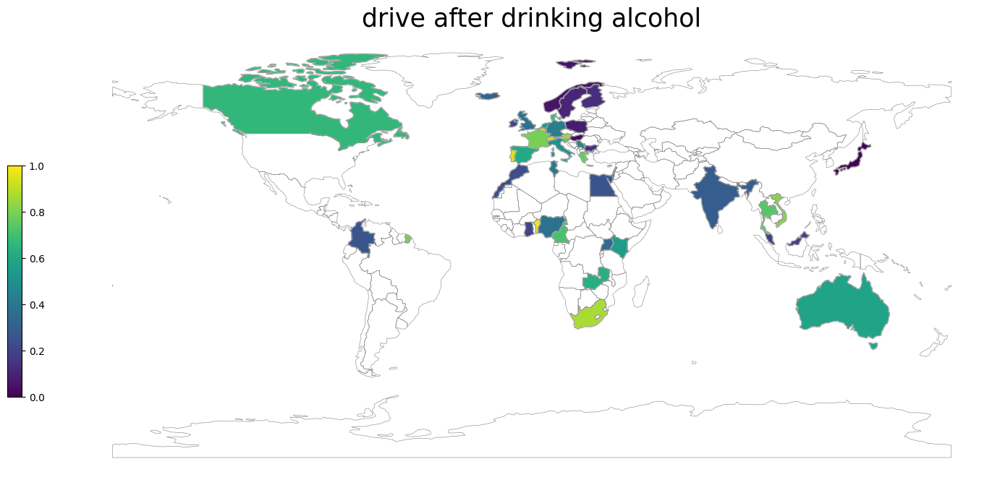

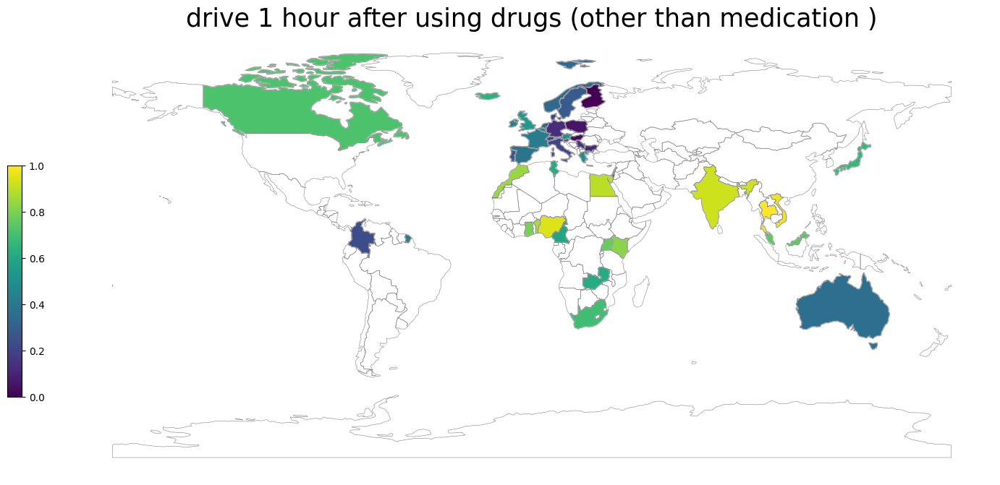

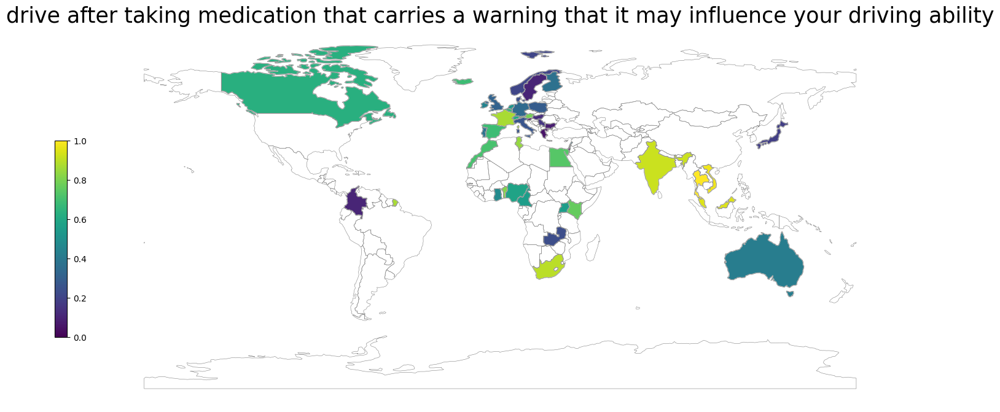

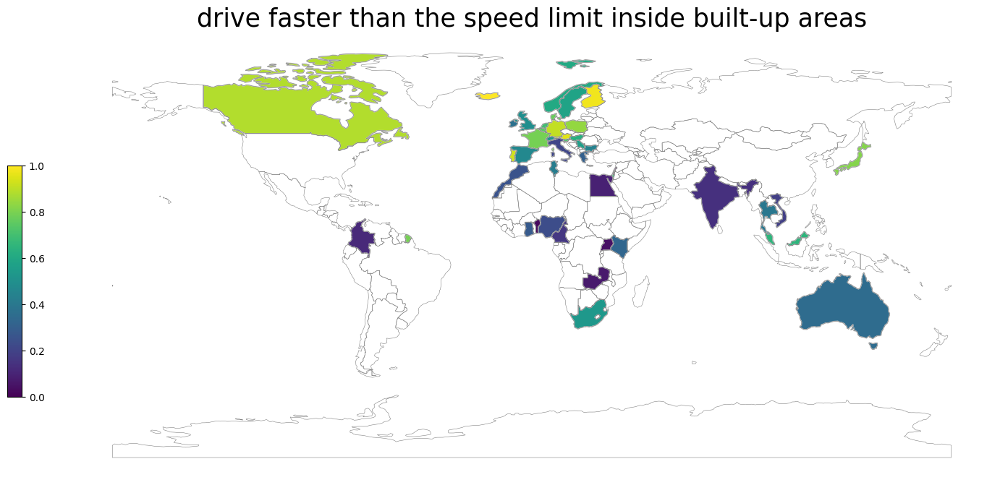

...

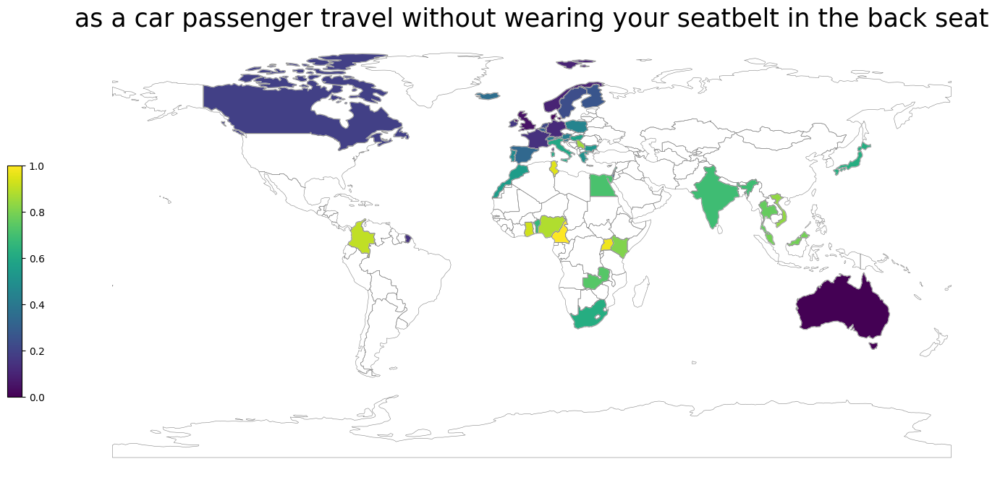

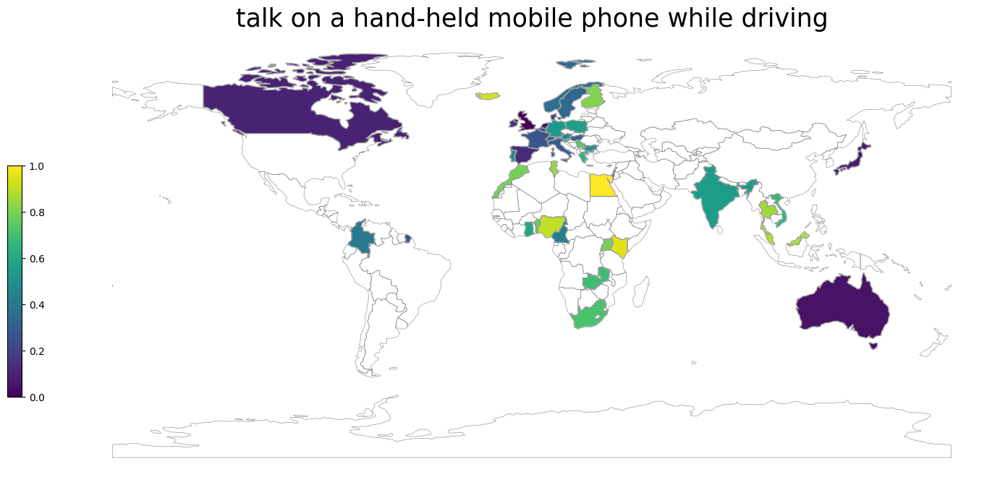

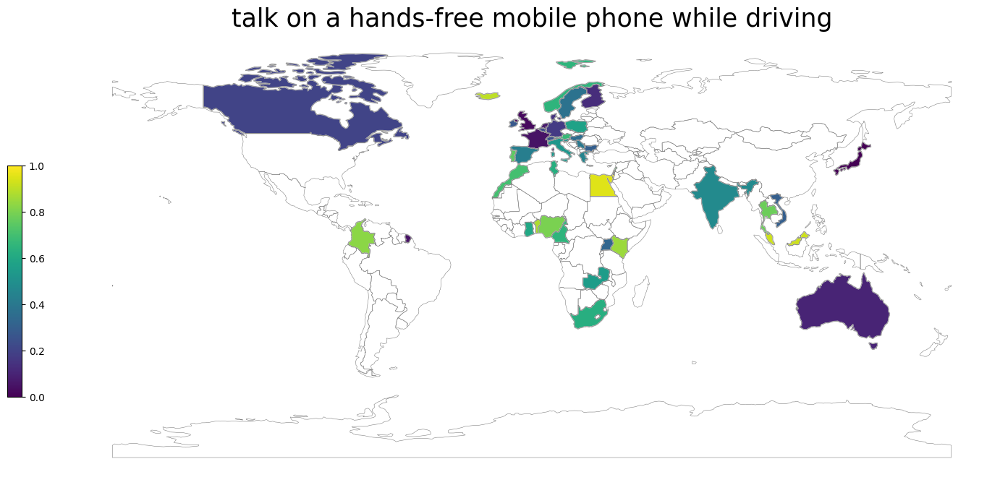

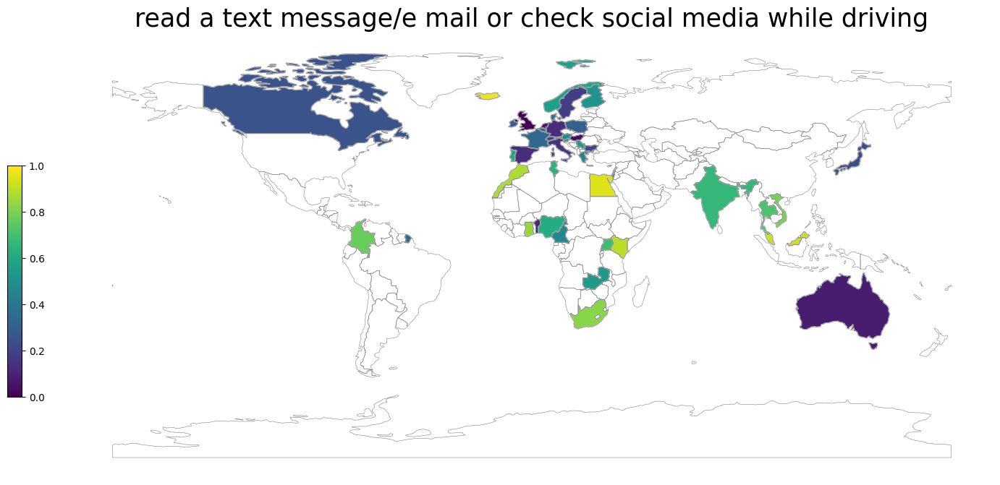

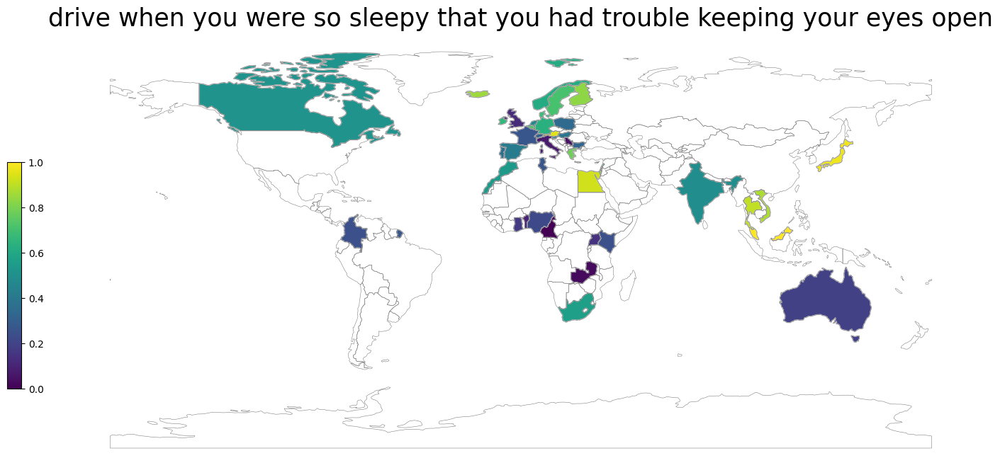

In [55]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data)

### Self-declared behaviour - moped riders + motorcyclist (Q12_3), cyclists (Q12_4), pedestrians (Q12_5)
Table 8: Self-declared behaviour as a moped riders and motorcyclists, cyclist, and pedestrian, by country and region (% at least once in the past 30 days –
scores 2 to 5 on a 5-point scale from 1 “never” to 5 “[almost] always”).

In [56]:
data = pd.read_excel(file,sheet_name=3)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/self_declared_behaviour_moped_motor_cyclist_pedestrian.csv')
data

,Country,ride when you may have been over the legal limit for drinking and driving,ride faster than the speed limit outside built-up areas (but not on motorways/fr eeways),ride a moped or motorcycle without a helmet,read a text message/emai l or check social media while riding a moped or motorcycle,cycle when you think you may have had too much to drink,cycle without a helmet,cycle while listening to music through headphones,read a text message/em ail or check social media while cycling,cycle on the road next to the cycle lane,listen to music through headphones as a pedestrian while walking in the streets,read a text message/em ail or check social media while walking in the streets,cross the road when a pedestrian light is red,cross the road at places other than at a nearby (distance <30m*) pedestrian crossing
0,Australia,0.307,0.459,0.293,0.297,0.149,0.297,0.371,0.174,0.347,0.338,0.523,0.416,0.653
1,Austria,0.218,0.523,0.198,0.185,0.178,0.691,0.214,0.144,0.359,0.274,0.607,0.43,0.718
2,Belgium,0.213,0.424,0.233,0.218,0.282,0.828,0.283,0.225,0.372,0.274,0.555,0.429,0.715
3,Benin,0.144,0.34,0.314,0.209,0.217,0.485,0.391,0.174,0.464,0.581,0.742,0.364,0.623
4,Bulgaria,0.098,0.327,0.303,0.164,0.067,0.675,0.303,0.13,0.546,0.317,0.565,0.248,0.634
5,Cameroon,0.167,0.288,0.46,0.152,0.173,0.731,0.423,0.269,0.442,0.621,0.81,0.482,0.79
6,Canada,0.527,0.634,0.495,0.505,0.219,0.516,0.388,0.238,0.435,0.377,0.477,0.456,0.693
7,Colombia,0.097,0.387,0.343,0.215,0.128,0.546,0.577,0.219,0.571,0.59,0.614,0.507,0.721
8,Czech Republic,0.094,0.419,0.217,0.076,0.264,0.701,0.235,0.128,0.295,0.288,0.62,0.377,0.777
9,Denmark,0.28,0.549,0.378,0.256,0.278,0.72,0.339,0.226,0.305,0.354,0.584,0.458,0.698


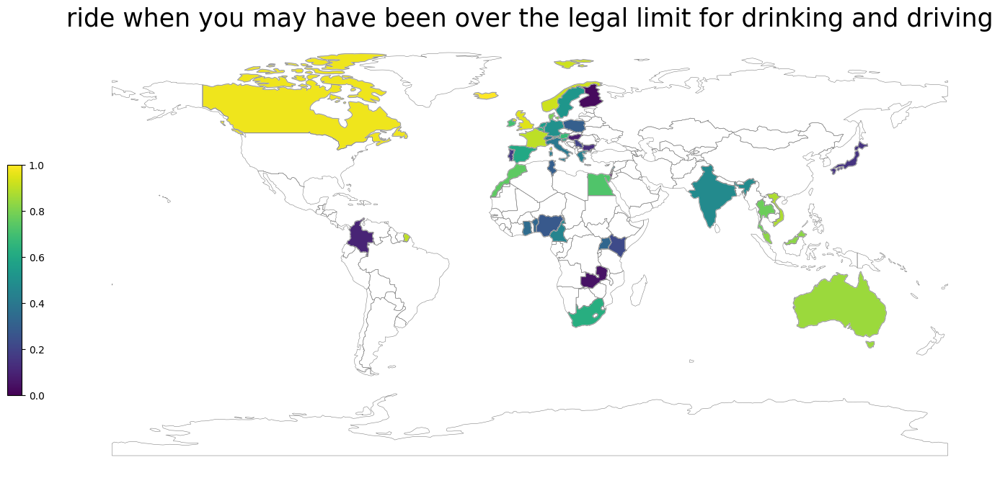

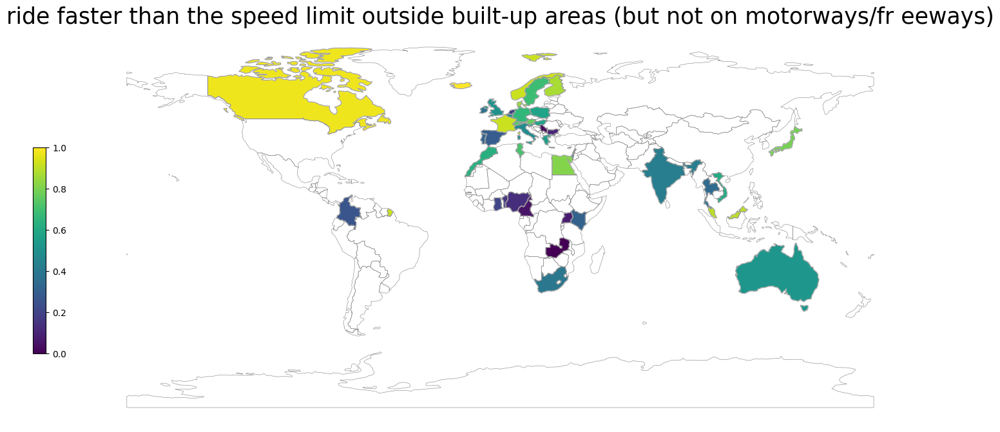

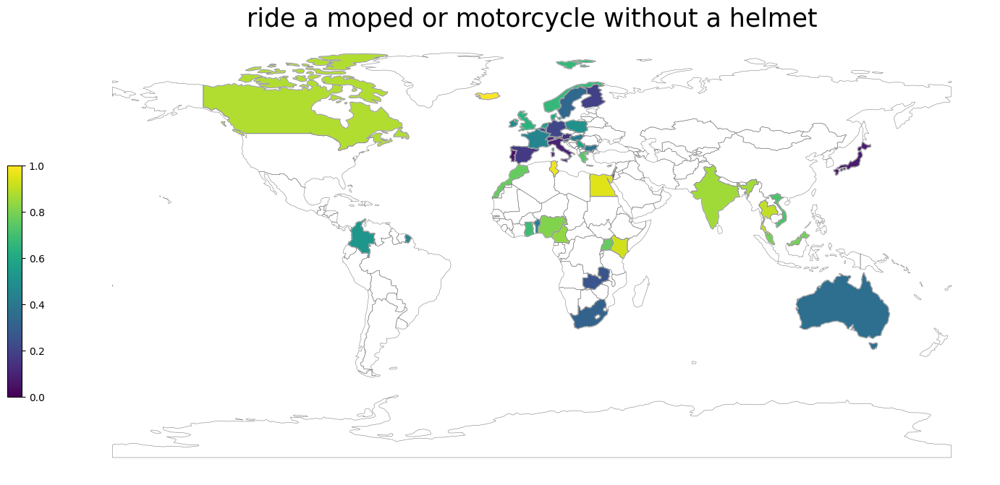

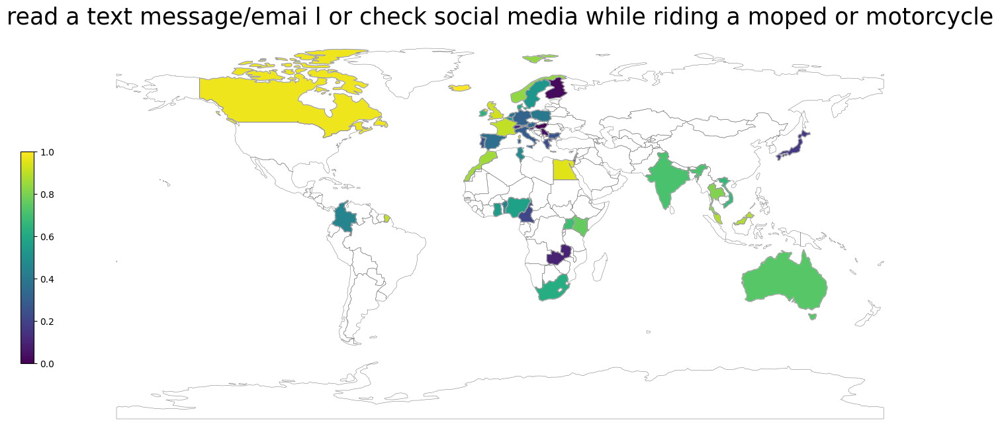

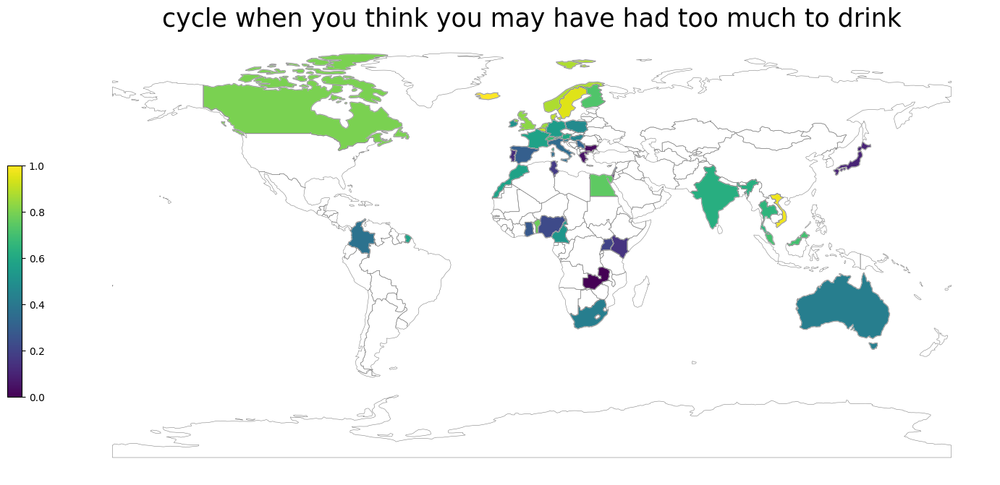

...

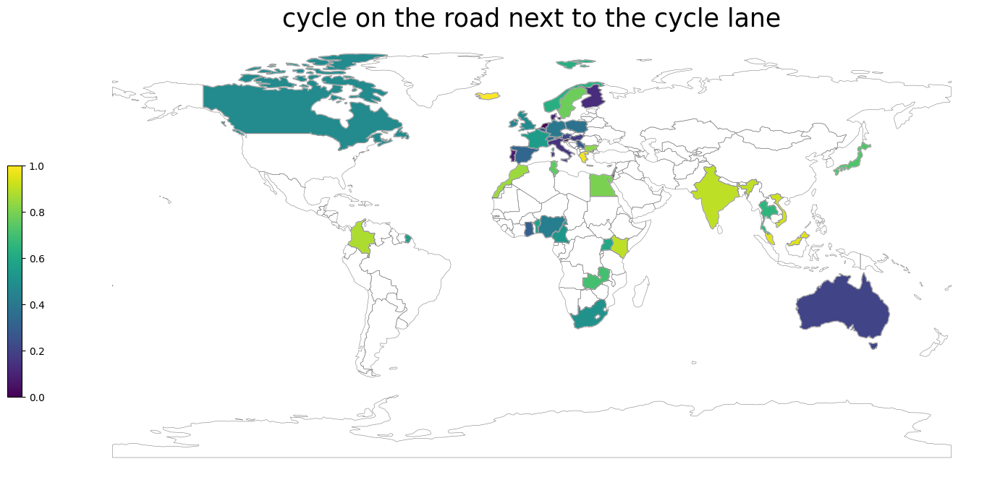

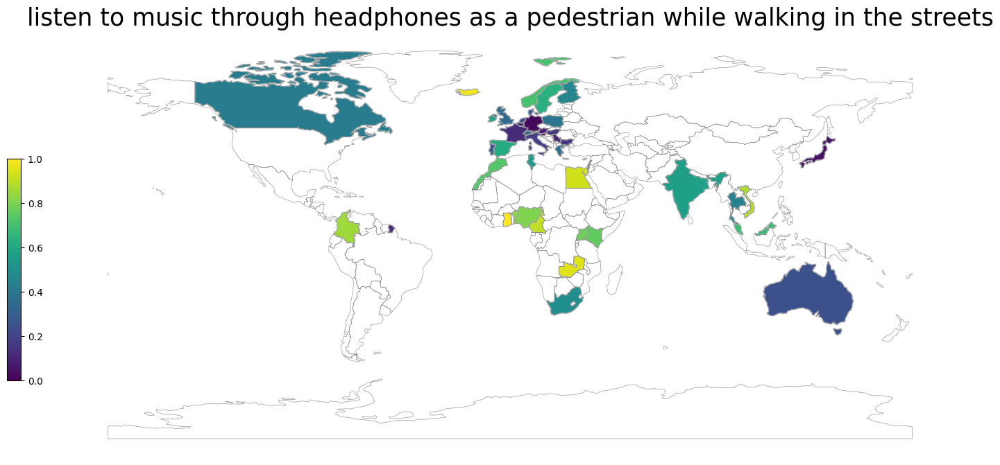

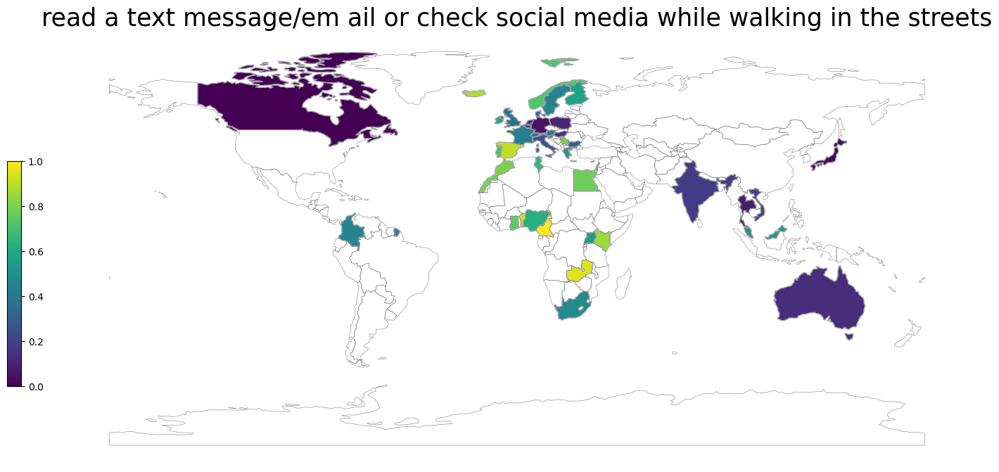

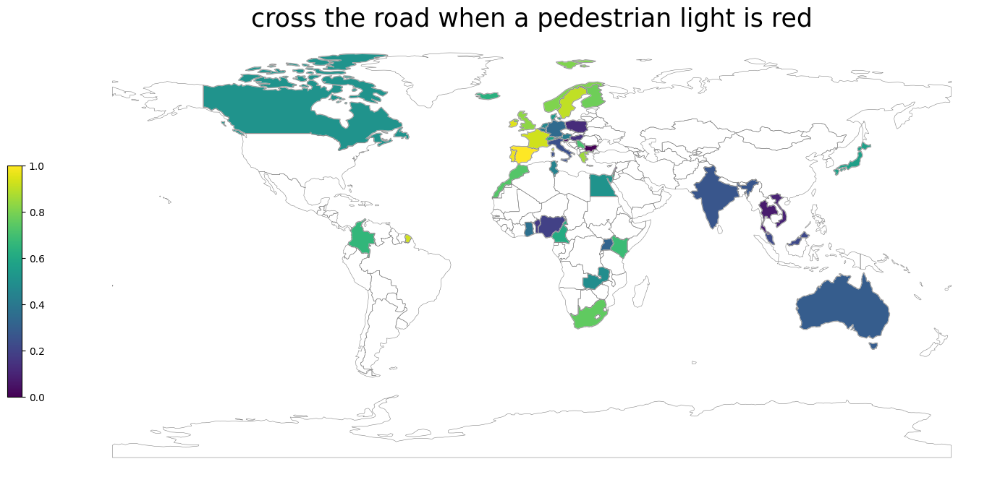

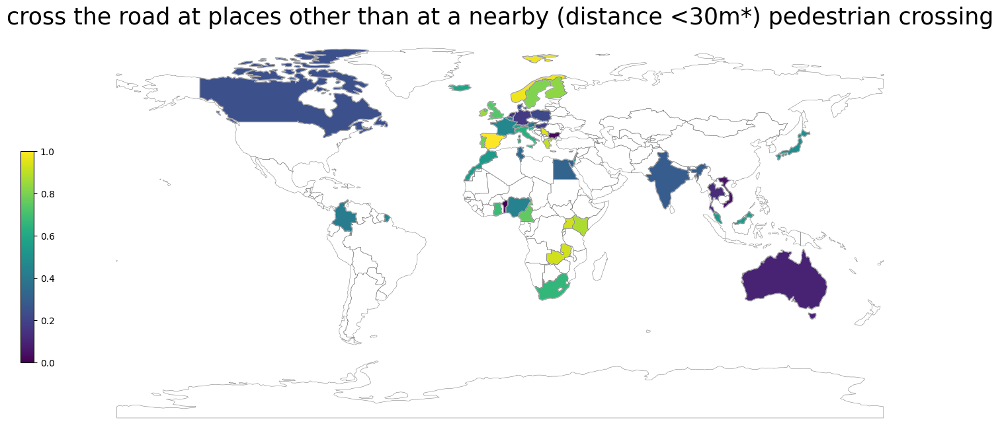

In [57]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data)

### Social acceptability (Q13)
Table 9: Social acceptability of unsafe behaviour in traffic, by country and region (“Where you live, how acceptable would most other people say it is for a CAR
DRIVER to…” – % of acceptability – scores 4 and 5 on a 5-point scale from 1 “unacceptable” to 5 “acceptable”).

In [58]:
data = pd.read_excel(file,sheet_name=4)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/social_acceptability.csv')
data

,Country,drive when he/she may be over the legal limit for drinking and driving,drive 1 hour after using drugs (other than medication),drive faster than the speed limit outside built-up areas (but not on motorways/ freeways),not wear a seatbelt while driving,"transport children in the car without securing them (child’s car seat, seatbelt, etc.)",talk on a hand-held mobile phone while driving,"read a text message/email or check social media (e.g. Facebook, twitter, etc.) while driving"
0,Australia,0.027,0.034,0.083,0.018,0.023,0.044,0.04
1,Austria,0.066,0.038,0.292,0.114,0.049,0.175,0.093
2,Belgium,0.046,0.033,0.146,0.061,0.034,0.06,0.04
3,Benin,0.066,0.058,0.116,0.202,0.182,0.124,0.116
4,Bulgaria,0.054,0.038,0.177,0.155,0.098,0.205,0.115
5,Cameroon,0.167,0.103,0.279,0.446,0.358,0.181,0.137
6,Canada,0.037,0.04,0.136,0.045,0.042,0.058,0.051
7,Colombia,0.029,0.025,0.087,0.083,0.104,0.057,0.067
8,Czech Republic,0.012,0.009,0.086,0.056,0.018,0.033,0.019
9,Denmark,0.017,0.019,0.132,0.041,0.014,0.033,0.03


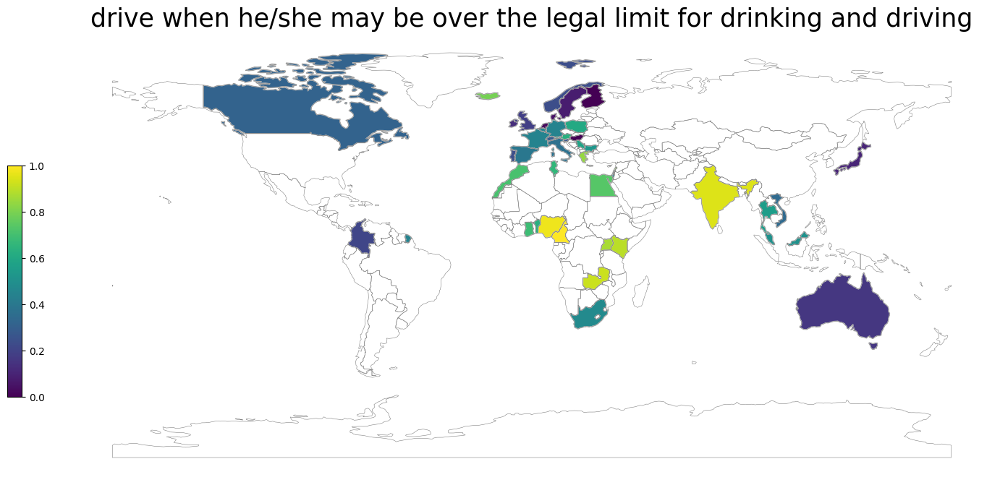

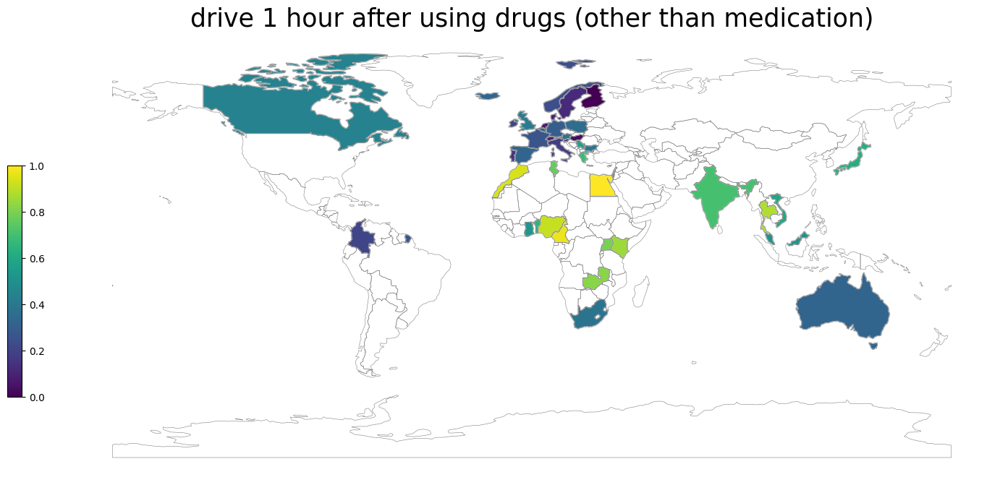

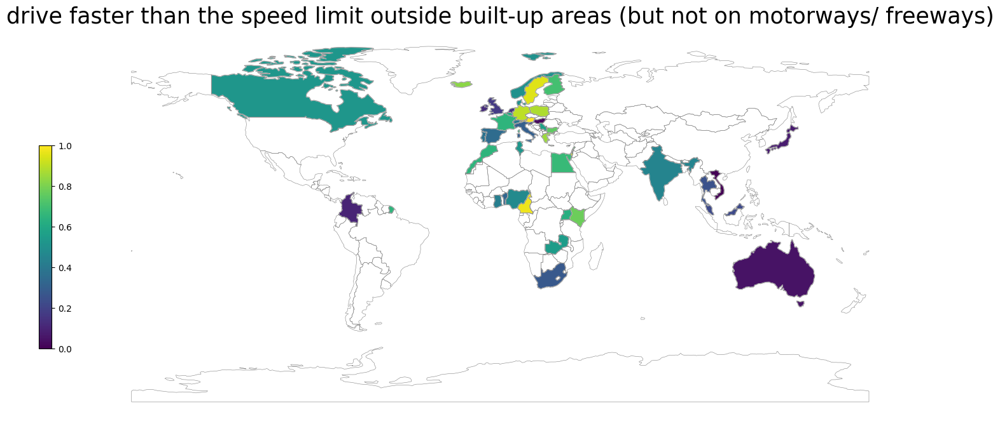

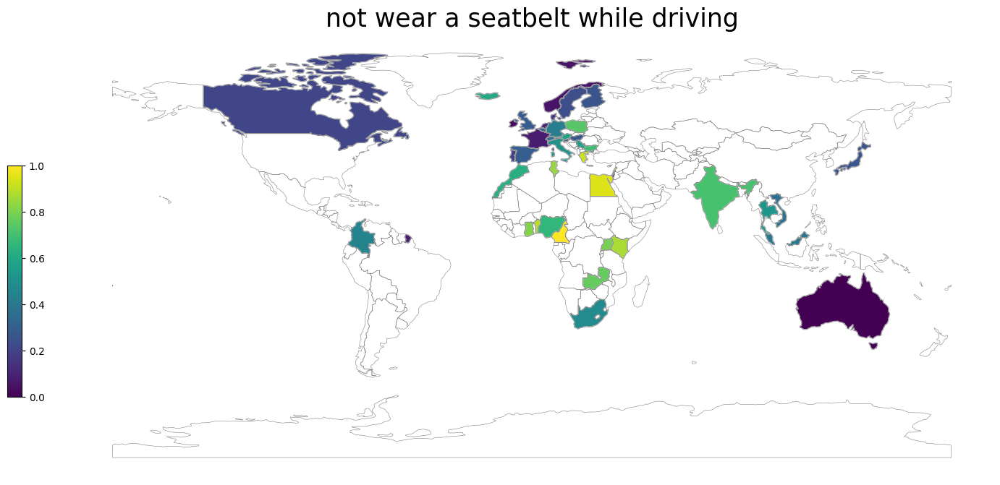

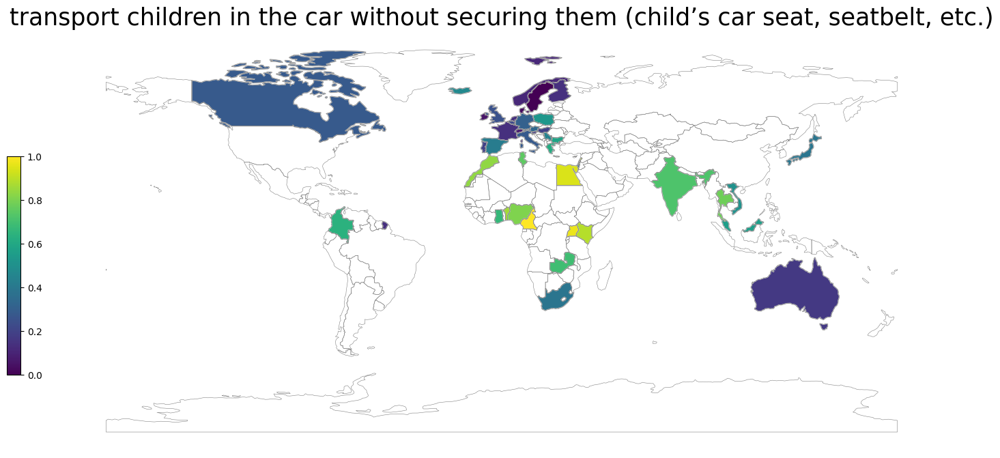

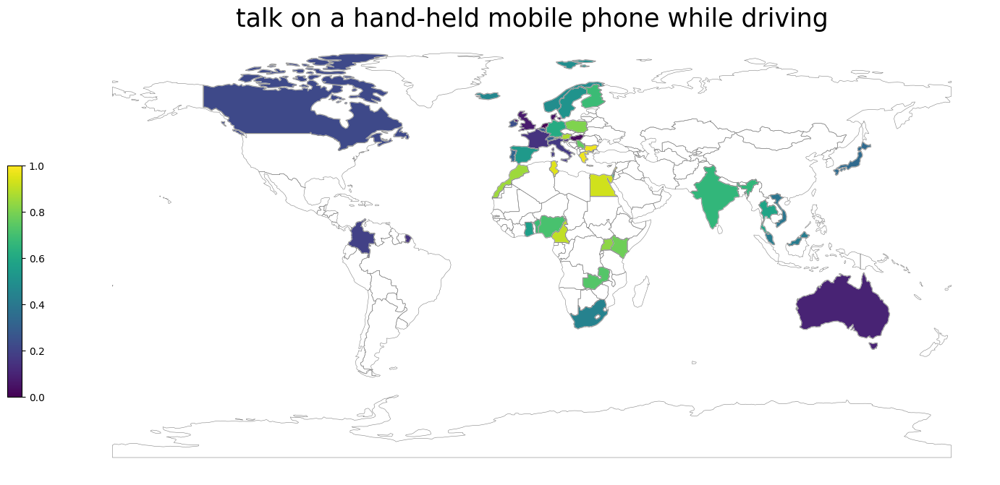

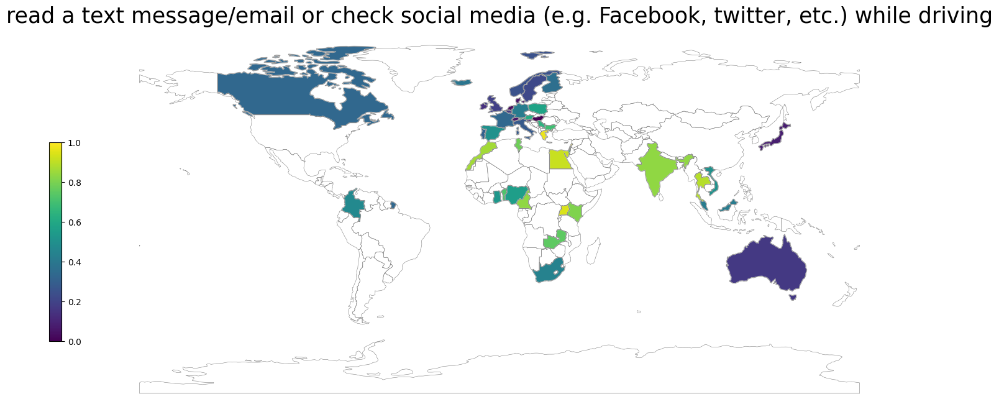

In [59]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data)

### Personal acceptability (Q14)
Table 10: Personal acceptability of unsafe behaviour in traffic, by country and region (“How acceptable do you, personally, feel it is for a CAR DRIVER to…” –
% of acceptability – scores 4 and 5 on a 5-point scale from 1 “unacceptable” to 5 “acceptable”).

In [60]:
data = pd.read_excel(file,sheet_name=5)
data.rename(
    columns={
    "Column1" : "Country",
    "Column2" : "drive when he/she may be over the legal limit for drinking and driving",
    "Column3" : "drive 1 hour after using drugs (other than medication)",
    "Column4" : "drive after taking a medication that may influence the ability to drive",
    "Column5" : "drive faster than the speed limit inside builtup areas",
    "Column6" : "drive faster than the speed limit outside builtup areas (but not on motorways/freeways)",
    "Column7" : "drive faster than the speed limit on motorways/freeways",
    "Column8" : "not wear a seatbelt while driving",
    "Column9" : "transport children in the car without securing them (child’s car seat, seatbelt, etc.)",
    "Column10" : "talk on a hand-held mobile phone while driving",
    "Column11" : "talk on a hand-free mobile phone while driving",
    "Column12" : "read a text message/email or check social media while driving",
    "Column13" : "drive when they’re so sleepy that they have trouble keeping their eyes open",
    "Column14" : "Country",
    }, inplace=True)
data = data.drop([0,1]).reset_index(drop=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%2", na=False)
    data[col][mask] = data[col][mask].str.rstrip("2")
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/personal_acceptability.csv')
data

,Country,drive when he/she may be over the legal limit for drinking and driving,drive 1 hour after using drugs (other than medication),drive after taking a medication that may influence the ability to drive,drive faster than the speed limit inside builtup areas,drive faster than the speed limit outside builtup areas (but not on motorways/freeways),drive faster than the speed limit on motorways/freeways,not wear a seatbelt while driving,"transport children in the car without securing them (child’s car seat, seatbelt, etc.)",talk on a hand-held mobile phone while driving,talk on a hand-free mobile phone while driving,read a text message/email or check social media while driving,drive when they’re so sleepy that they have trouble keeping their eyes open
0,Australia,0.018,0.022,0.012,0.031,0.061,0.07,0.022,0.017,0.028,0.243,0.017,0.021
1,Austria,0.026,0.021,0.038,0.105,0.221,0.29,0.057,0.026,0.074,0.351,0.031,0.027
2,Belgium,0.031,0.018,0.023,0.06,0.117,0.18,0.039,0.016,0.019,0.323,0.017,0.013
3,Benin,0.029,0.037,0.062,0.017,0.045,0.095,0.07,0.079,0.05,0.202,0.058,0.021
4,Bulgaria,0.02,0.011,0.016,0.033,0.059,0.066,0.06,0.025,0.054,0.373,0.024,0.018
5,Cameroon,0.034,0.044,0.044,0.034,0.103,0.113,0.142,0.103,0.059,0.314,0.054,0.025
6,Canada,0.03,0.042,0.032,0.072,0.118,0.194,0.048,0.029,0.048,0.243,0.03,0.029
7,Colombia,0.011,0.009,0.014,0.025,0.055,0.06,0.024,0.032,0.02,0.196,0.021,0.01
8,Czech Republic,0.011,0.006,0.01,0.031,0.091,0.11,0.052,0.012,0.036,0.334,0.007,0.01
9,Denmark,0.009,0.01,0.014,0.025,0.108,0.157,0.034,0.011,0.02,0.229,0.012,0.008


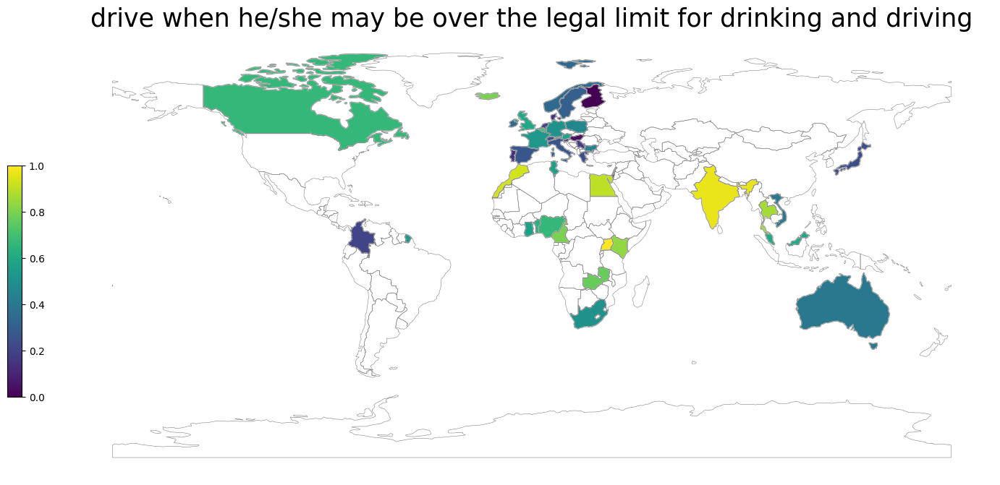

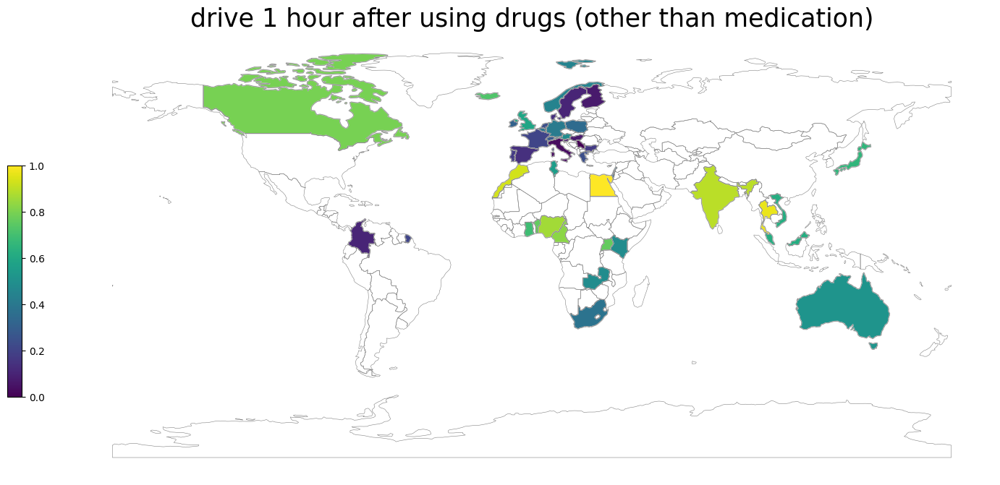

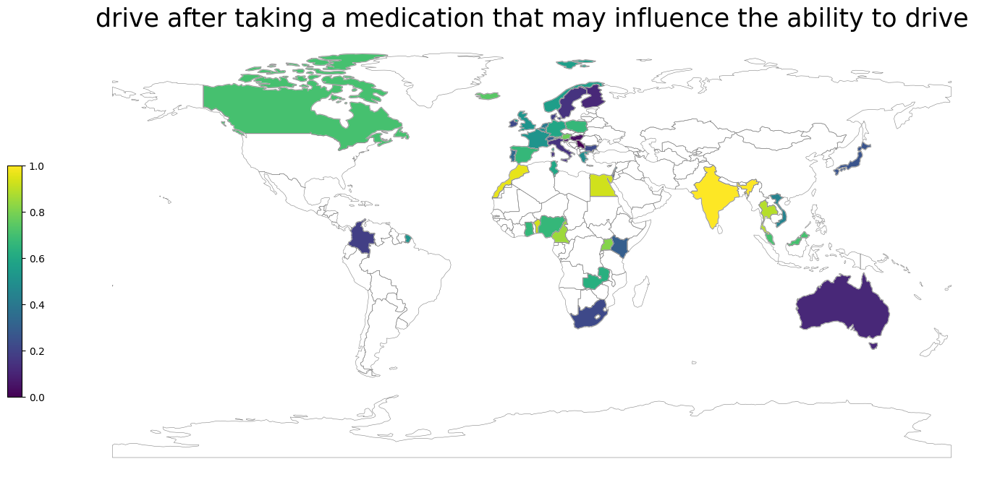

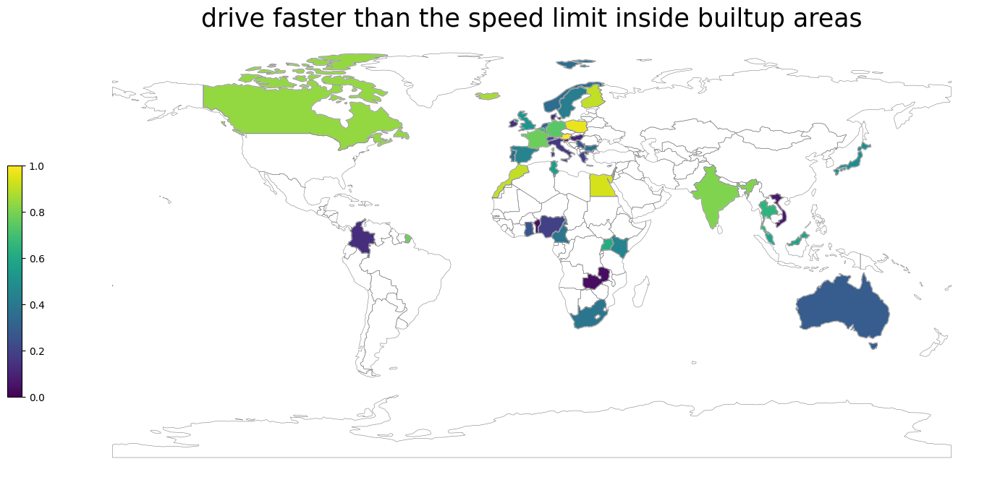

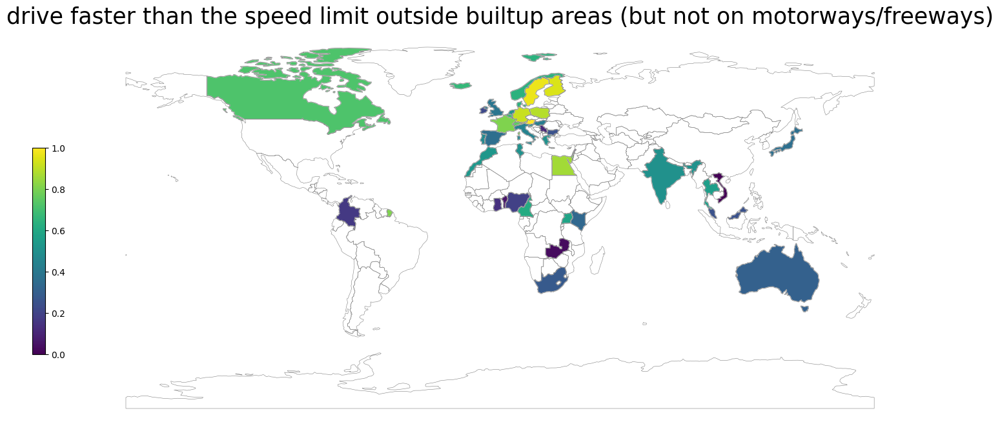

...

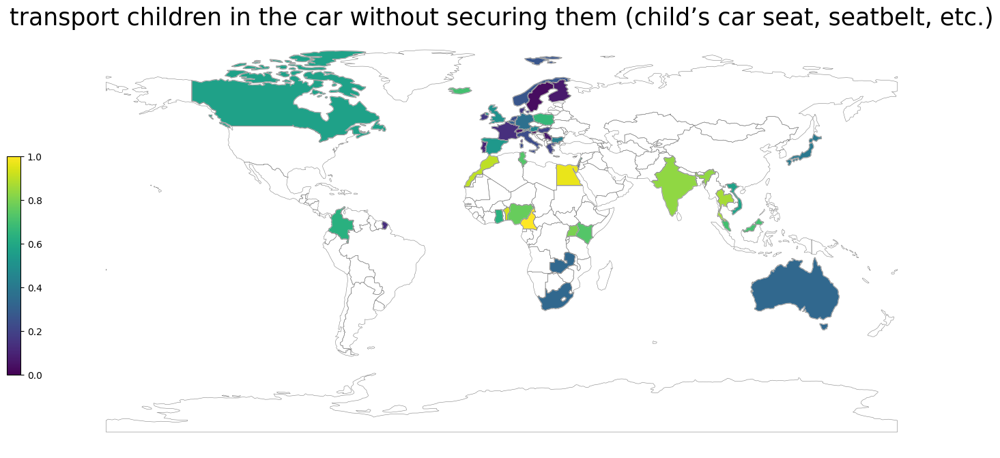

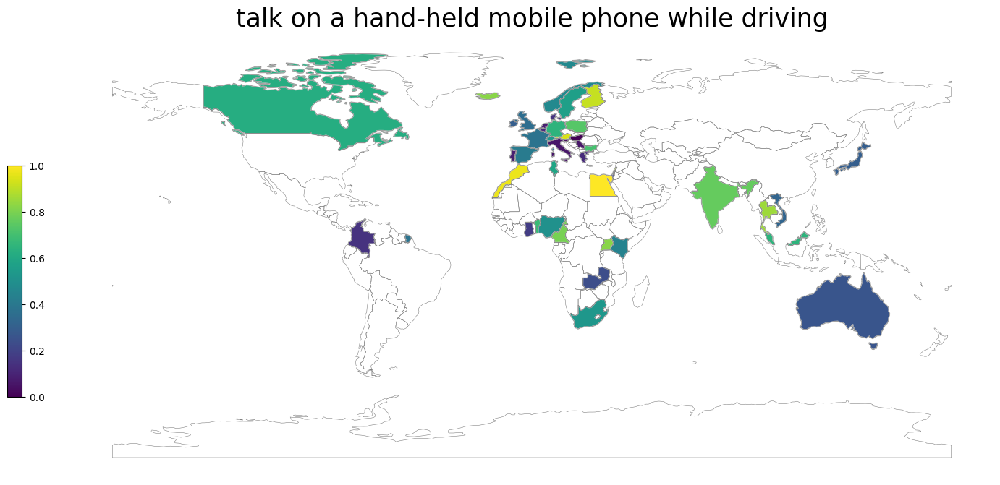

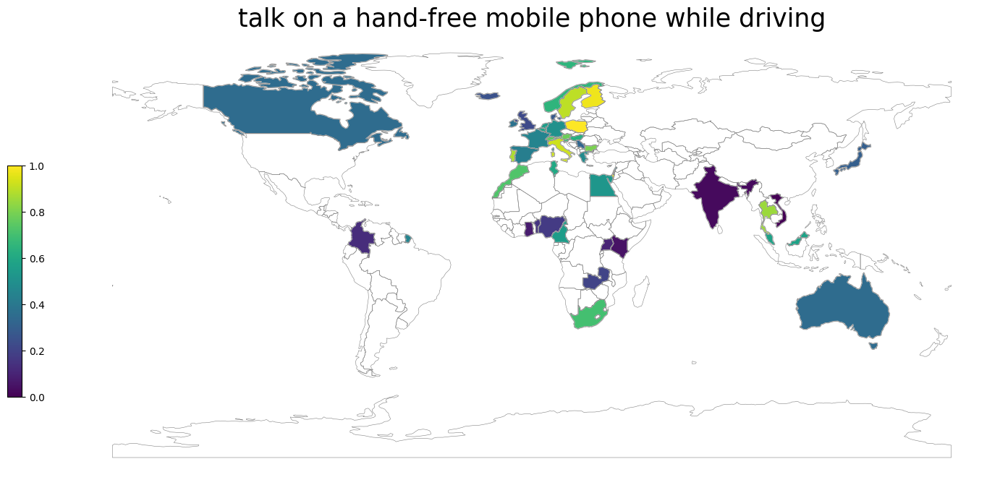

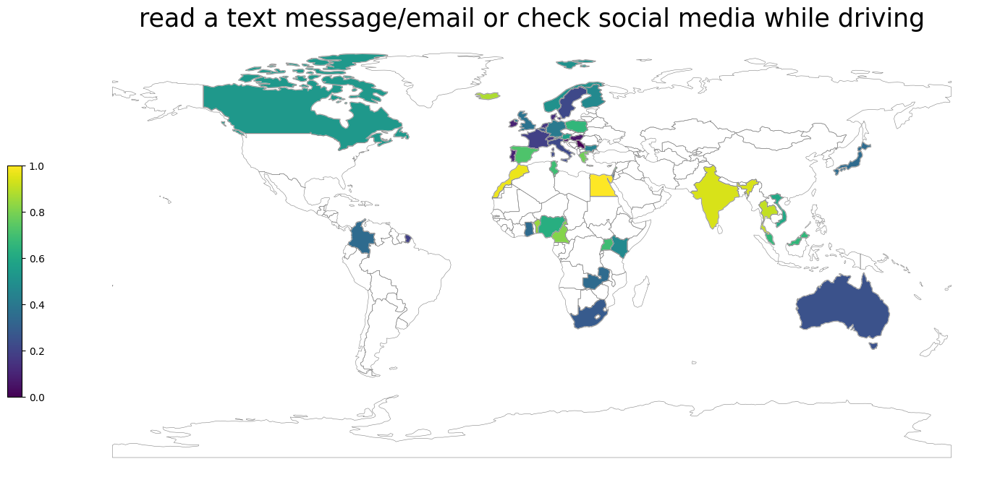

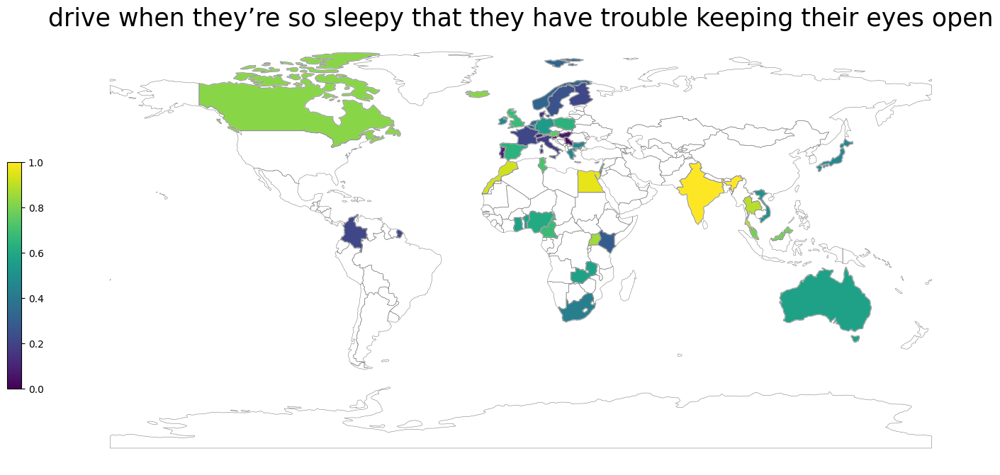

In [61]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data)

### Attitudes (Q15), risk perception (Q17), perceived behaviour control (Q15)
Table 11: Composite mean scores for Attitudes, Risk Perception, and Perceived Behaviour Control (PBC).

In [91]:
data = pd.read_excel(file,sheet_name=6)
data.rename(columns={"Column1" : "Country", "Column2" : "Attitudes", "Column4" : "Risk perception", "Column6" : "PBC DUI-alcohol", "Column8" : "PBC distraction-mobile phone", "Column10" : "PBC speeding"}, inplace=True)
data.to_csv('csv/attitudes_risk_behavioralcoltrol.csv')
data

,Country,Attitudes,Risk perception,PBC DUI-alcohol,PBC distraction-mobile phone,PBC speeding
0,Australia,1.35,4.41,1.40,1.42,1.71
1,Austria,1.62,4.26,1.76,1.67,2.46
2,Belgium,1.50,4.18,1.63,1.56,1.97
3,Benin,1.41,4.35,1.44,1.38,1.39
4,Bulgaria,1.45,4.41,1.33,1.39,1.55
5,Cameroon,1.57,4.63,1.53,1.60,1.50
6,Canada,1.49,4.21,1.51,1.48,1.96
7,Colombia,1.45,4.07,1.31,1.48,1.55
8,Czech Republic,1.42,4.65,1.25,1.42,1.82
9,Denmark,1.39,4.18,1.49,1.46,1.94


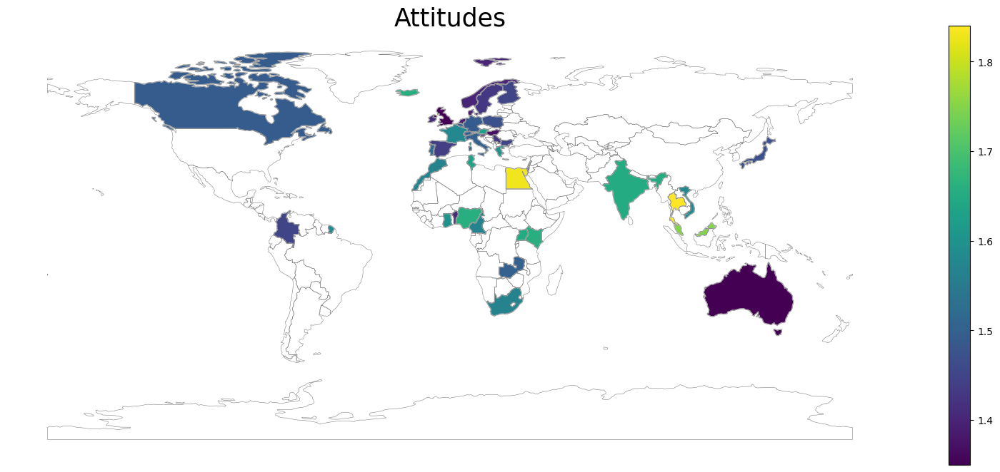

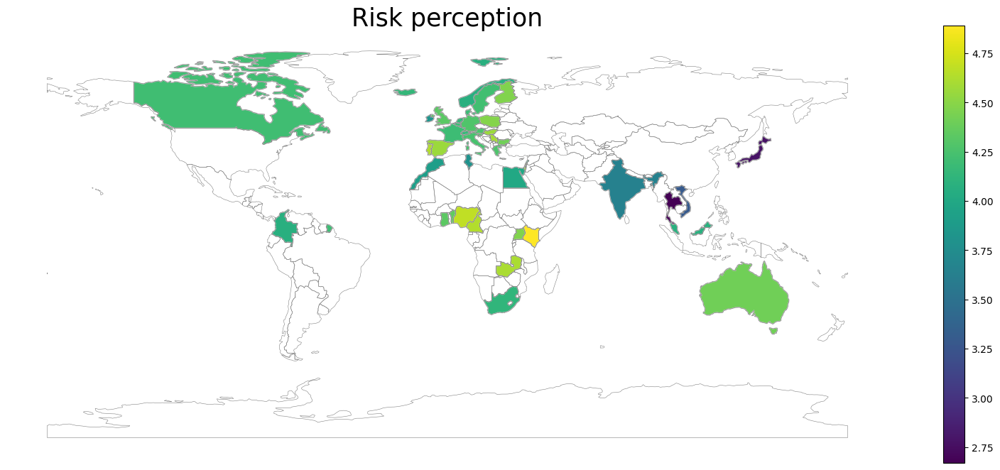

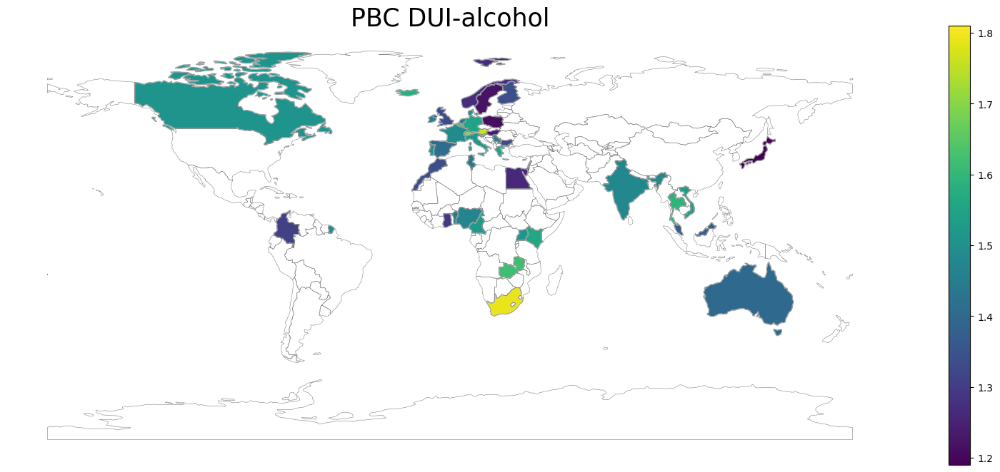

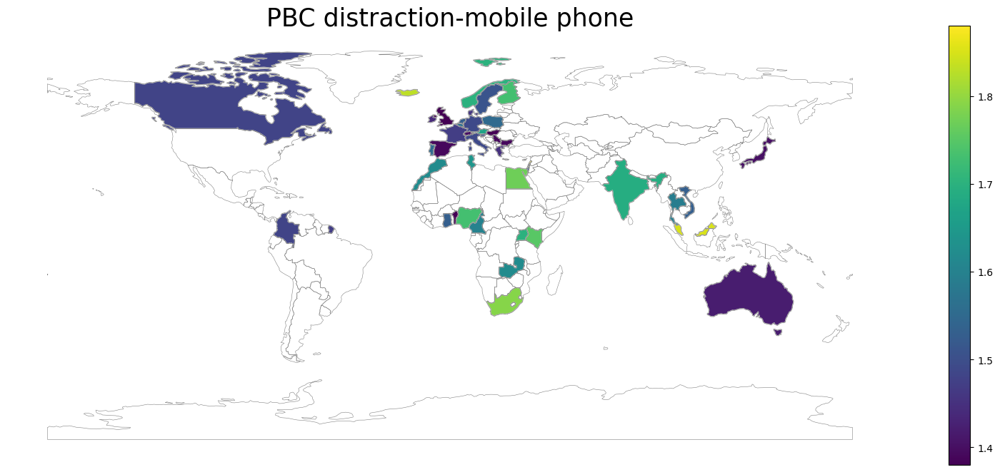

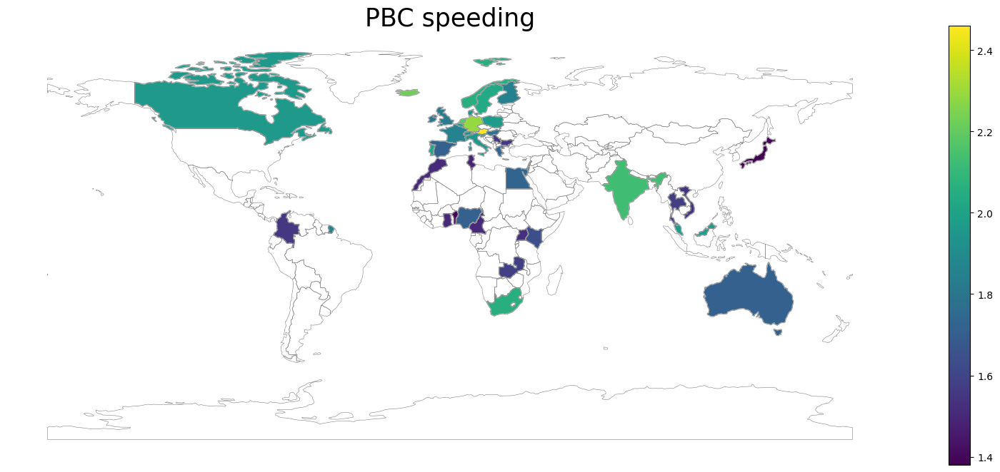

In [92]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data, free_legend=True)

### Safety feeling (Q16)
Table 12: Safety feeling, by country and region (mean score of a 11-point scale, where 0 = very unsafe
& 10 = very safe).

In [75]:
data = pd.read_excel(file,sheet_name=7)
data.rename(columns={"Column1" : "Country"}, inplace=True)
data.to_csv('csv/safety_feeling.csv')
data

,Country,Pedestrian,Cyclist,Moped rider /motorcyclist,Car as driver,Car as a passenger,Public transport
0,Australia,8.1,6.3,5.7,7.5,7.5,7.9
1,Austria,8.3,7.2,6.2,8.0,7.2,8.2
2,Belgium,6.7,5.6,5.4,7.0,6.7,7.6
3,Benin,7.9,5.0,4.3,7.5,6.4,6.2
4,Bulgaria,7.2,5.5,4.5,5.9,6.5,7.2
5,Cameroon,6.7,4.8,4.7,6.7,7.0,7.2
6,Canada,8.1,6.6,6.0,7.8,7.5,8.1
7,Colombia,6.3,5.3,4.8,6.7,7.0,6.6
8,Czech Republic,7.3,6.1,5.5,6.8,6.9,7.8
9,Denmark,8.4,7.3,6.4,8.2,7.7,8.1


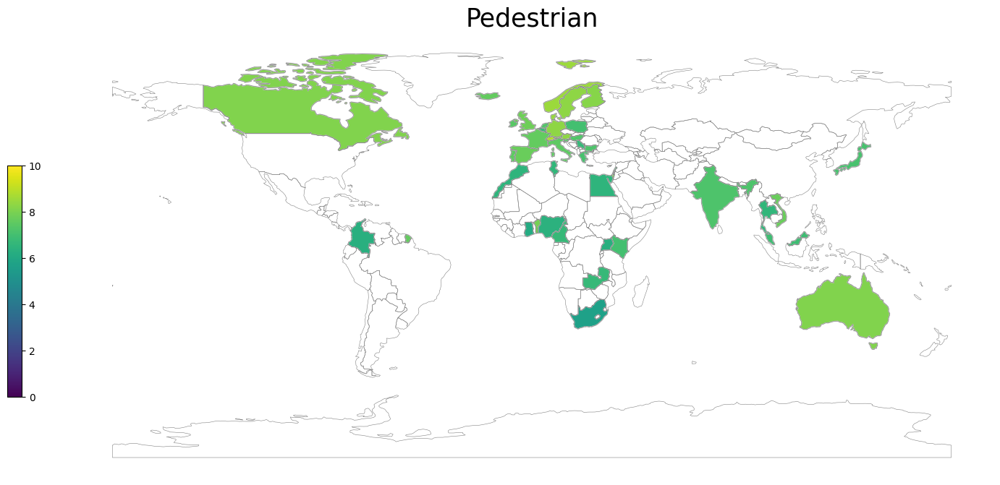

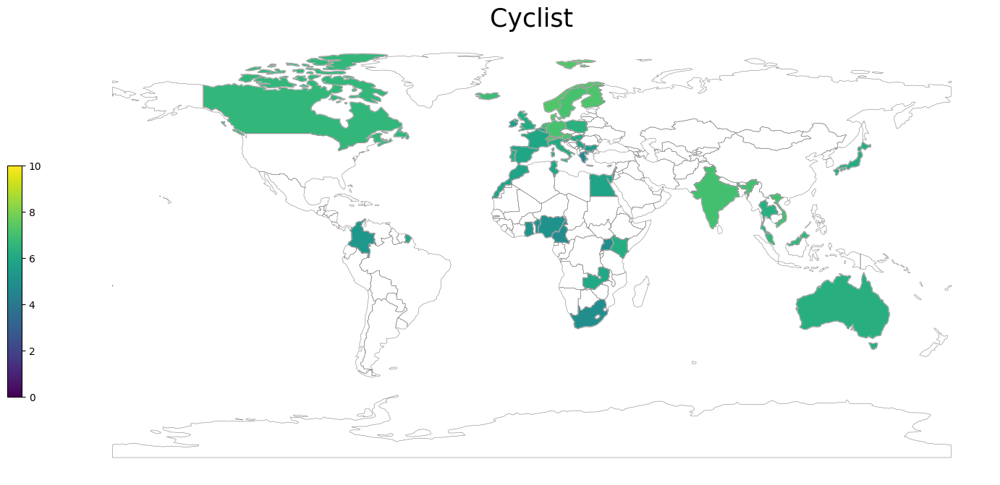

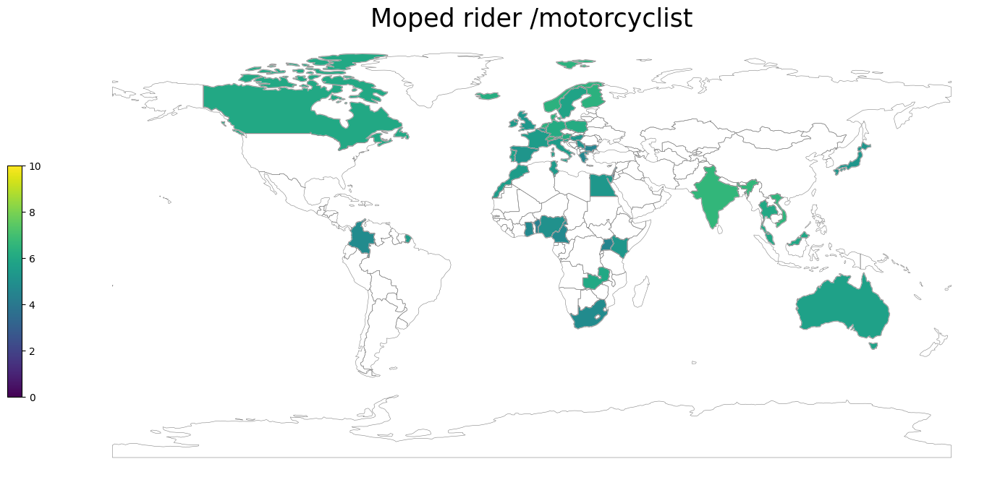

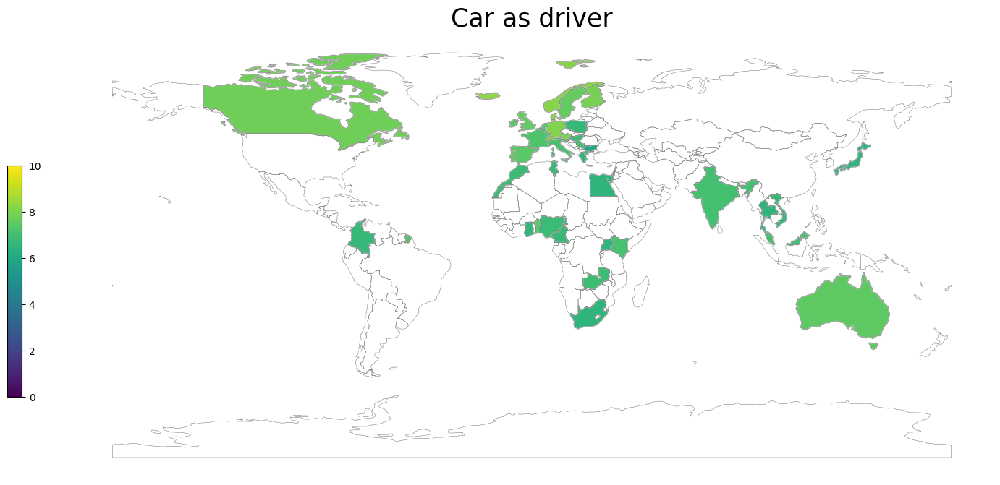

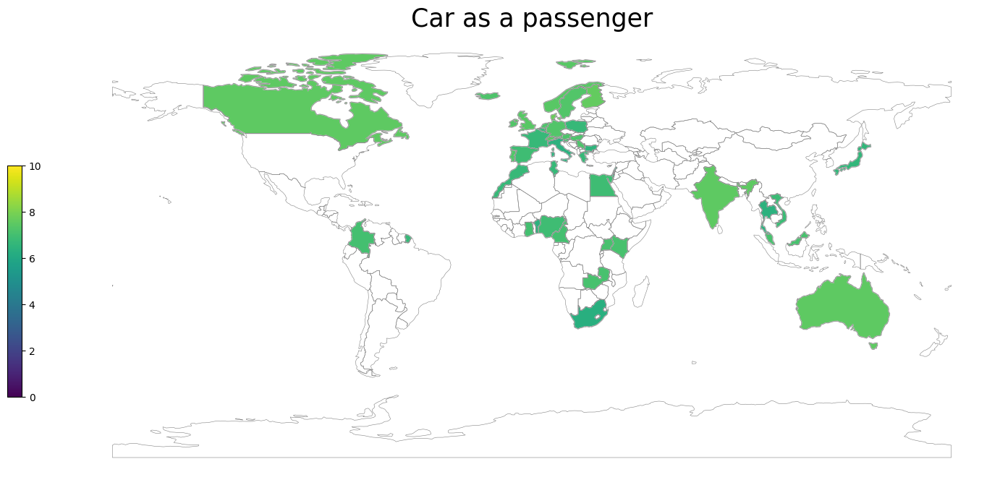

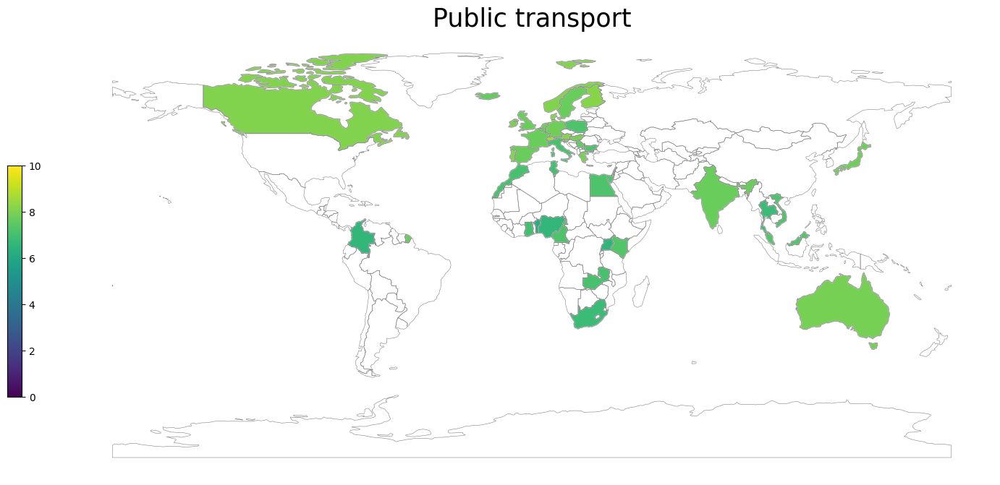

In [80]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data, lower=0, higher=10)

### Enforcement perception (Q20)
Table 13: Enforcement perception, by country and region (“On a typical journey, how likely is it that
you (as a CAR DRIVER) will be checked by the police for…” – % of likely – scores 5 to 7 on a 7-point
scale from 1 “very unlikely” to 7 “very likely”).

In [93]:
data = pd.read_excel(file,sheet_name=8)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/enforcment_perception.csv')
data

,Country,"alcohol, in other words, being subjected to a Breathalyser test",use of illegal drugs,respecting the speed limits,wearing your seatbelt,use of hand-held mobile phone to talk or text while driving
0,Australia,0.3,0.171,0.414,0.241,0.211
1,Austria,0.235,0.105,0.431,0.25,0.198
2,Belgium,0.218,0.143,0.385,0.196,0.157
3,Benin,0.146,0.078,0.194,0.223,0.175
4,Bulgaria,0.358,0.265,0.532,0.501,0.319
5,Cameroon,0.245,0.236,0.382,0.373,0.236
6,Canada,0.137,0.119,0.272,0.207,0.147
7,Colombia,0.427,0.273,0.473,0.513,0.309
8,Czech Republic,0.385,0.191,0.462,0.357,0.247
9,Denmark,0.109,0.08,0.26,0.155,0.128


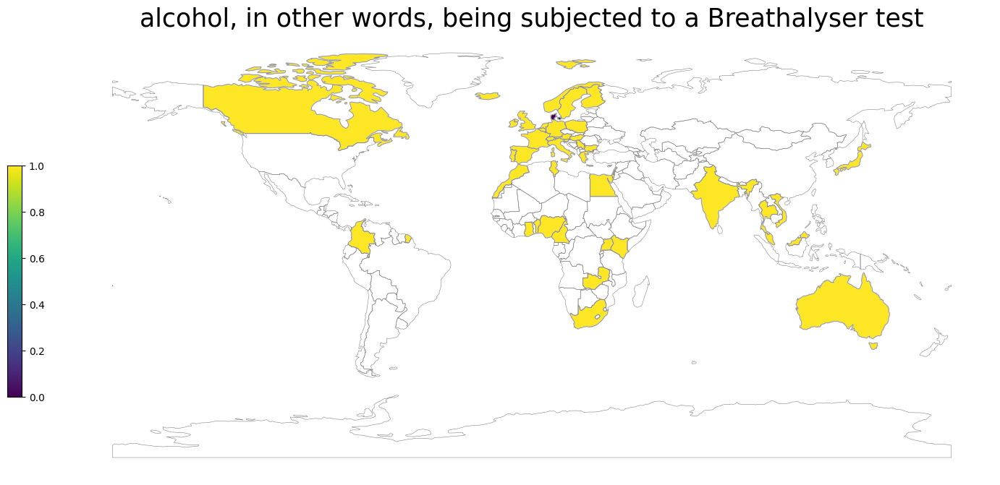

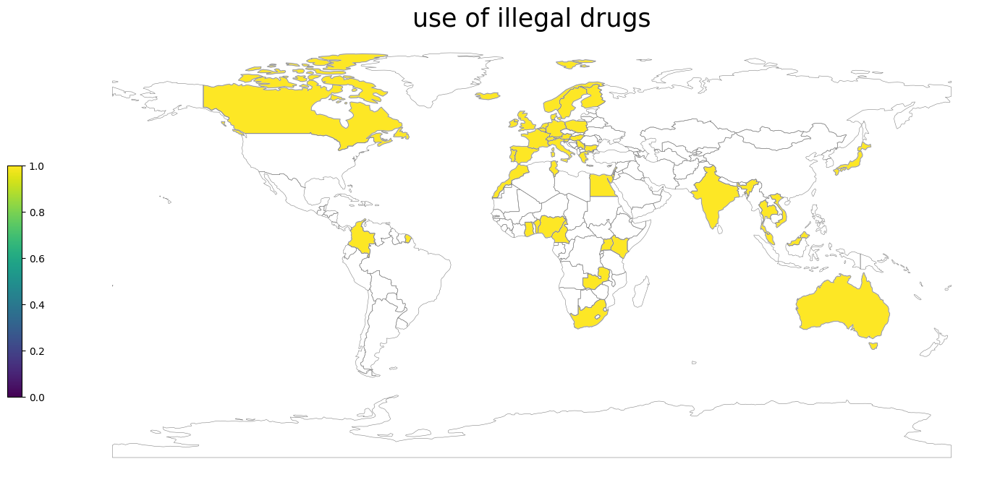

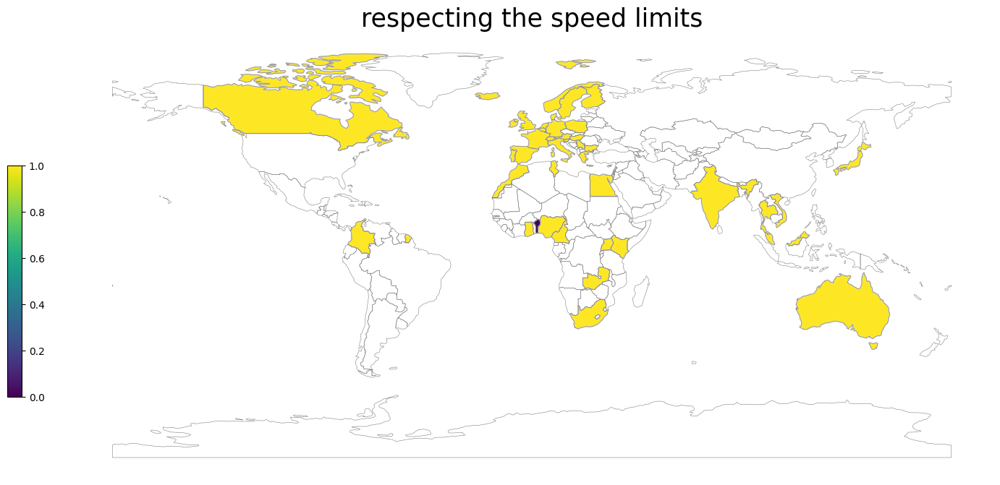

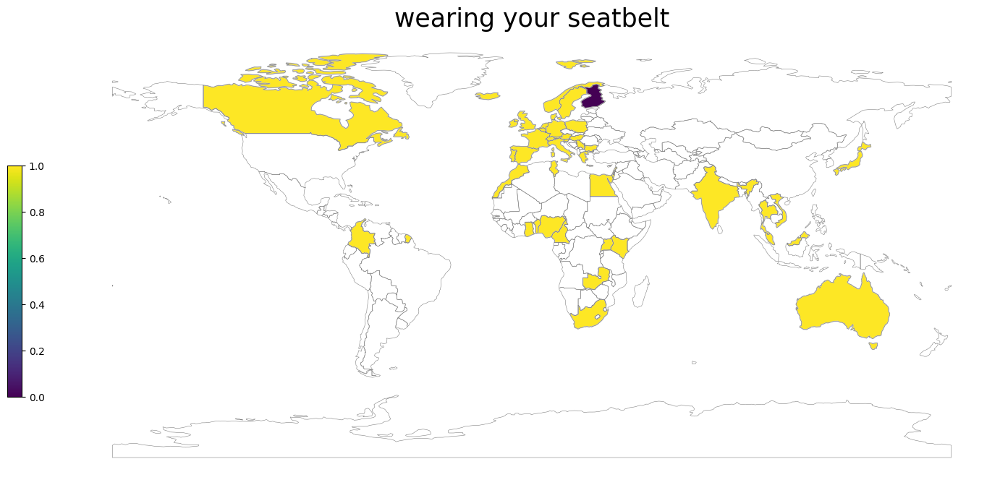

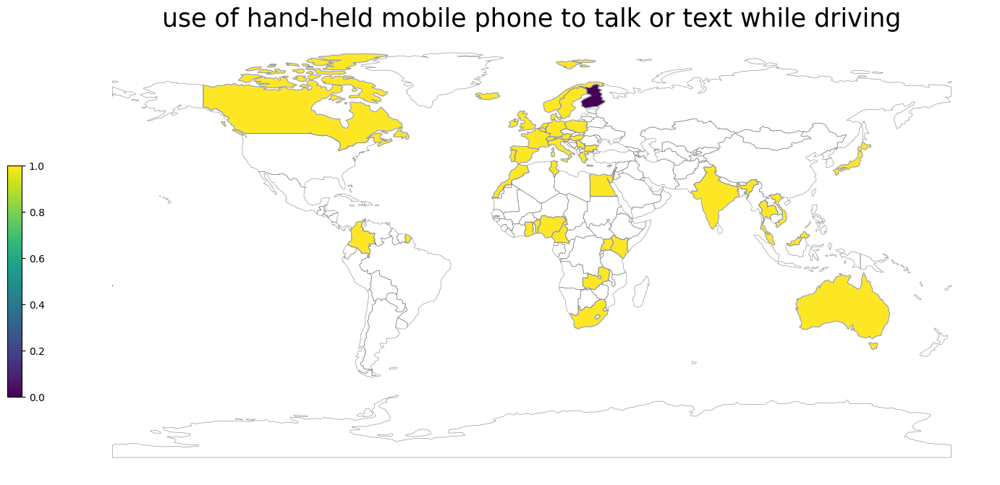

In [95]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data)

### Self-declared enforcement (Q21/Q22)
Table 14: Self-declared enforcement, by country and region (“In the past 12 months, how many times
have you been checked by the police for …?” – % at least once in the past 12 months).

In [104]:
data = pd.read_excel(file,sheet_name=9)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = (data[col][mask].str.rstrip("%").astype(float)/100).round(3)
data.to_csv('csv/self_declared_enforcement.csv')
data

,Country,"checked by the police for using alcohol while DRIVING A CAR (i.e., being subjected to a Breathalyser",checked by the police for the use of drugs (other than medication) while DRIVING A CAR
0,Australia,0.471,0.105
1,Austria,0.192,0.036
2,Belgium,0.241,0.041
3,Benin,0.039,0.04
4,Bulgaria,0.413,0.138
5,Cameroon,0.28,0.083
6,Canada,0.081,0.042
7,Colombia,0.33,0.1
8,Czech Republic,0.417,0.075
9,Denmark,0.089,0.022


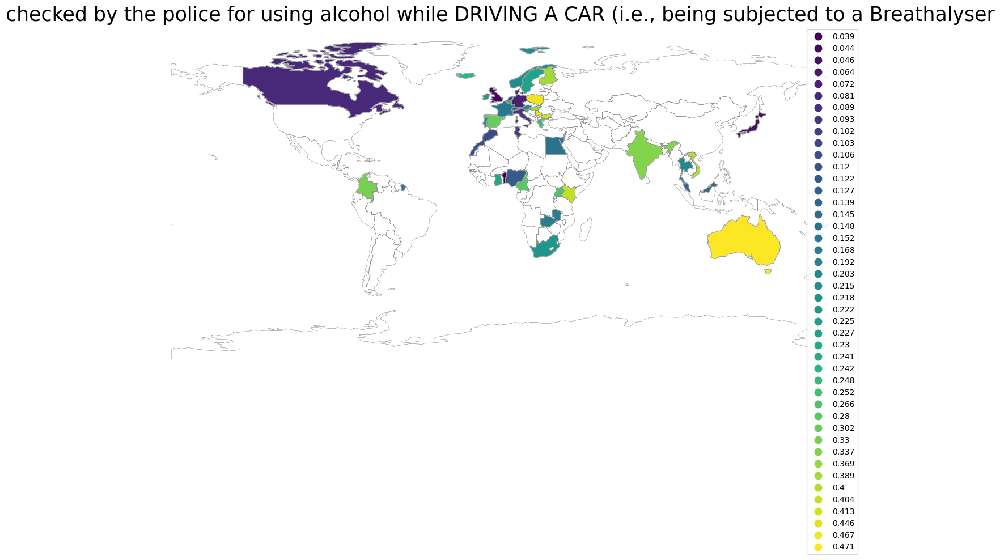

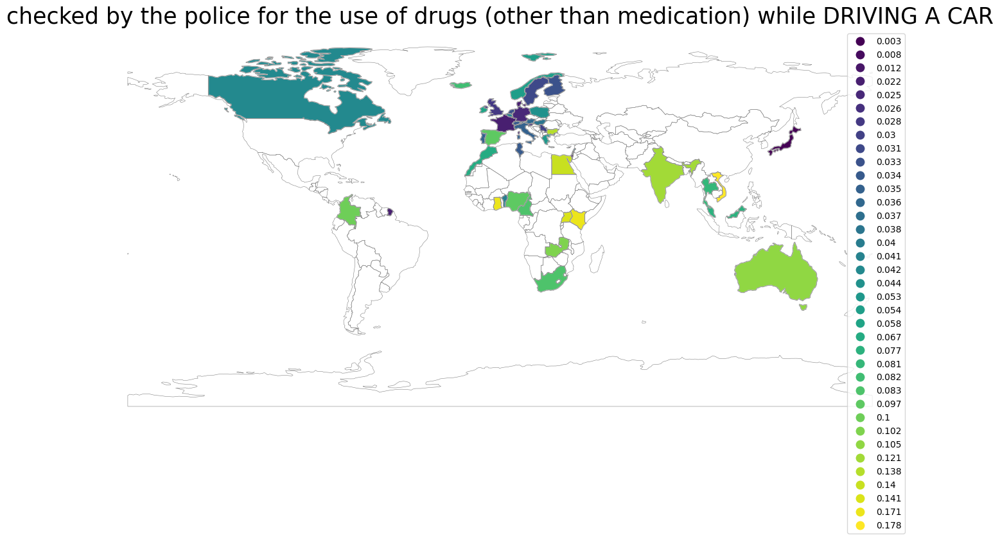

In [105]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data, free_legend=True)

### Support for policy measures (Q18)
Table 15: Support for policy measures, by country and region (“Do you oppose or support a legal obligation to …?” – % of support – scores 4 to 5 on a 5-point
scale from 1 “oppose” to 5 “support”).

In [106]:
data = pd.read_excel(file,sheet_name=10)
data.rename(
    columns={
    "Column1" : "Country",
    "Column2" : "install an alcohol “interlock” for drivers who have been caught drunk driving on more than one occasion",
    "Column3" : "have zero tolerance for alcohol (0,0 ‰) for novice drivers (licence obtained less than 2 years)",
    "Column4" : "have zero tolerance for alcohol (0,0 ‰) for all drivers",
    "Column5" : "install Intelligent Speed Assistance (ISA) in new cars",
    "Column6" : "install Dynamic Speed Warning signs",
    "Column7" : "have a seatbelt reminder system for the front and back seats in new cars",
    "Column8" : "require all cyclists to wear a helmet",
    "Column9" : "require cyclists under the age of 12 to wear a helmet",
    "Column10" : "require all moped drivers and motorcyclists to wear a helmet",
    "Column11" : "require pedestrians to wear reflective material when walking in the streets in the dark",
    "Column12" : "require cyclists to wear reflective material when cycling in the dark",
    "Column13" : "require moped drivers and motorcyclists to wear reflective material when driving in the dark",
    "Column14" : "have zero tolerance for using any type of mobile phone while driving (hand-held or handsfree) for all drivers",
    "Column15" : "not using headphones (or earbuds) while walking in the streets",
    "Column16" : "not using headphones (or earbuds) while riding a bicycle",
    }, inplace=True)
data = data.drop([0,1,2,3,4])
data = data.reset_index(drop=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%2", na=False)
    data[col][mask] = data[col][mask].str.rstrip("2")
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/support_policy_measures.csv')
data

,Country,install an alcohol “interlock” for drivers who have been caught drunk driving on more than one occasion,"have zero tolerance for alcohol (0,0 ‰) for novice drivers (licence obtained less than 2 years)","have zero tolerance for alcohol (0,0 ‰) for all drivers",install Intelligent Speed Assistance (ISA) in new cars,install Dynamic Speed Warning signs,have a seatbelt reminder system for the front and back seats in new cars,require all cyclists to wear a helmet,require cyclists under the age of 12 to wear a helmet,require all moped drivers and motorcyclists to wear a helmet,require pedestrians to wear reflective material when walking in the streets in the dark,require cyclists to wear reflective material when cycling in the dark,require moped drivers and motorcyclists to wear reflective material when driving in the dark,have zero tolerance for using any type of mobile phone while driving (hand-held or handsfree) for all drivers,not using headphones (or earbuds) while walking in the streets,not using headphones (or earbuds) while riding a bicycle
0,Australia,0.847,0.854,0.506,0.575,0.658,0.814,0.84,0.9,0.894,0.311,0.825,0.772,0.576,0.388,0.648
1,Austria,0.716,0.832,0.512,0.435,0.543,0.662,0.577,0.844,0.91,0.571,0.776,0.759,0.368,0.491,0.659
2,Belgium,0.761,0.781,0.576,0.579,0.648,0.81,0.583,0.838,0.824,0.602,0.813,0.809,0.475,0.446,0.627
3,Benin,0.913,0.934,0.905,0.955,0.967,0.967,0.93,0.901,0.959,0.74,0.909,0.839,0.744,0.554,0.751
4,Bulgaria,0.897,0.832,0.811,0.791,0.835,0.834,0.755,0.878,0.916,0.649,0.921,0.92,0.462,0.572,0.729
5,Cameroon,0.897,0.828,0.74,0.882,0.956,0.966,0.922,0.941,0.961,0.549,0.868,0.848,0.608,0.652,0.779
6,Canada,0.85,0.856,0.591,0.49,0.618,0.769,0.757,0.897,0.884,0.54,0.813,0.832,0.627,0.437,0.664
7,Colombia,0.893,0.881,0.898,0.775,0.879,0.9,0.943,0.946,0.952,0.462,0.925,0.921,0.65,0.439,0.638
8,Czech Republic,0.783,0.861,0.737,0.561,0.67,0.688,0.672,0.909,0.883,0.654,0.825,0.824,0.434,0.471,0.718
9,Denmark,0.845,0.691,0.524,0.557,0.636,0.764,0.542,0.805,0.891,0.637,0.828,0.787,0.565,0.366,0.542


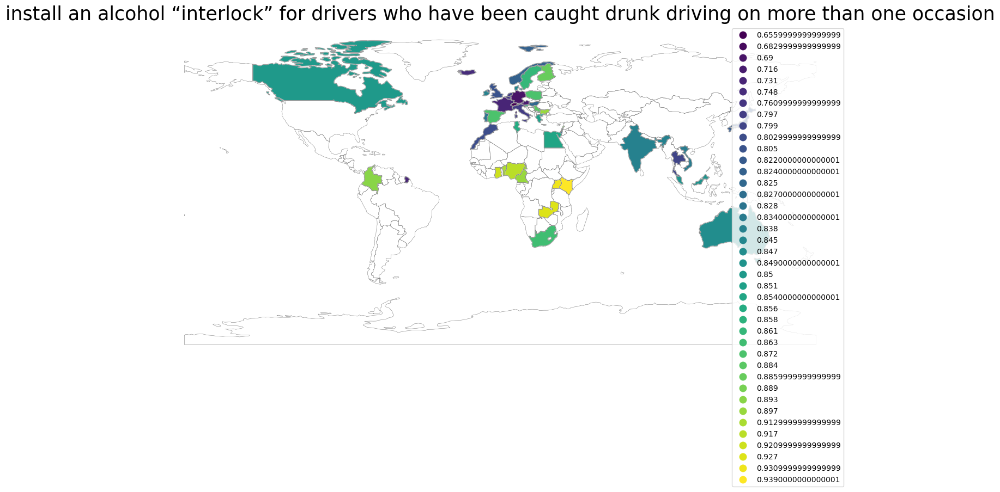

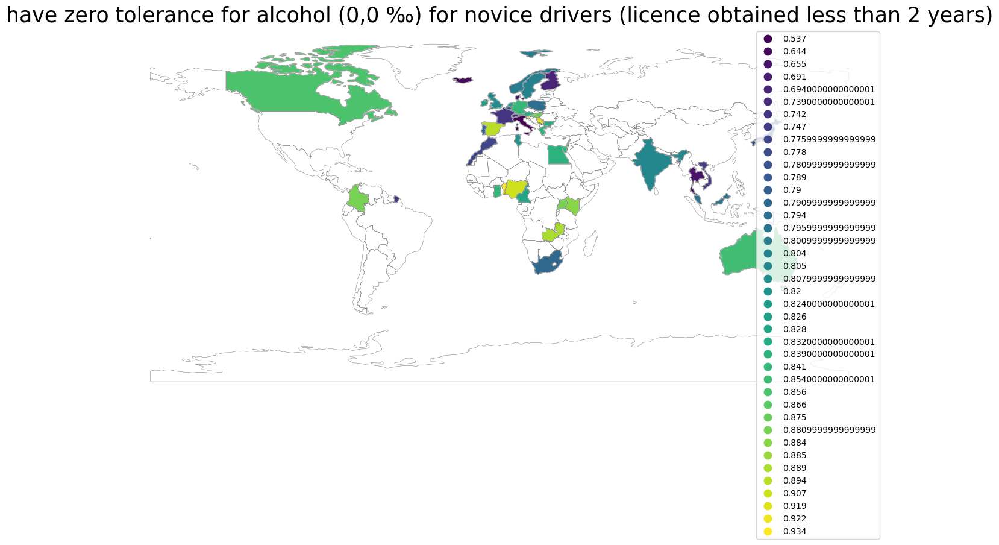

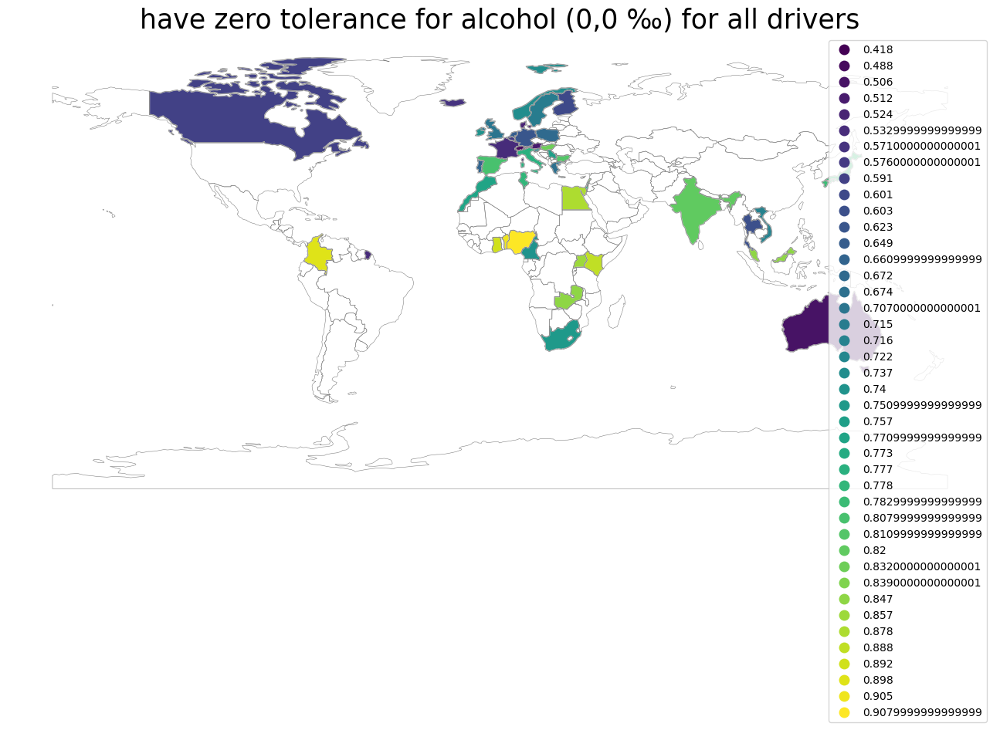

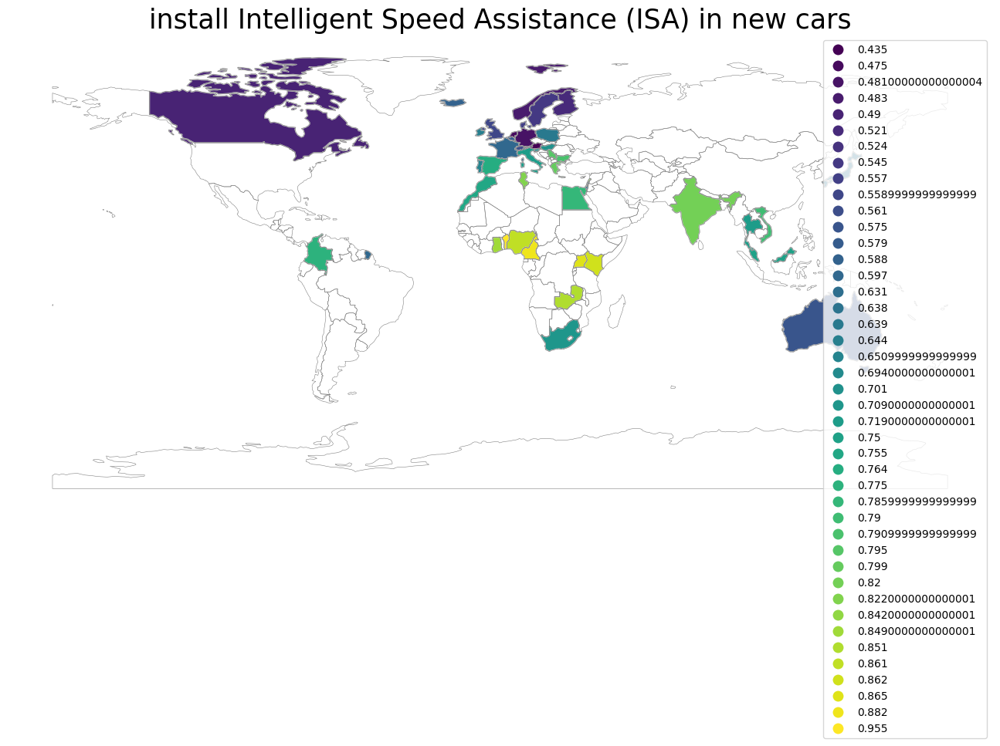

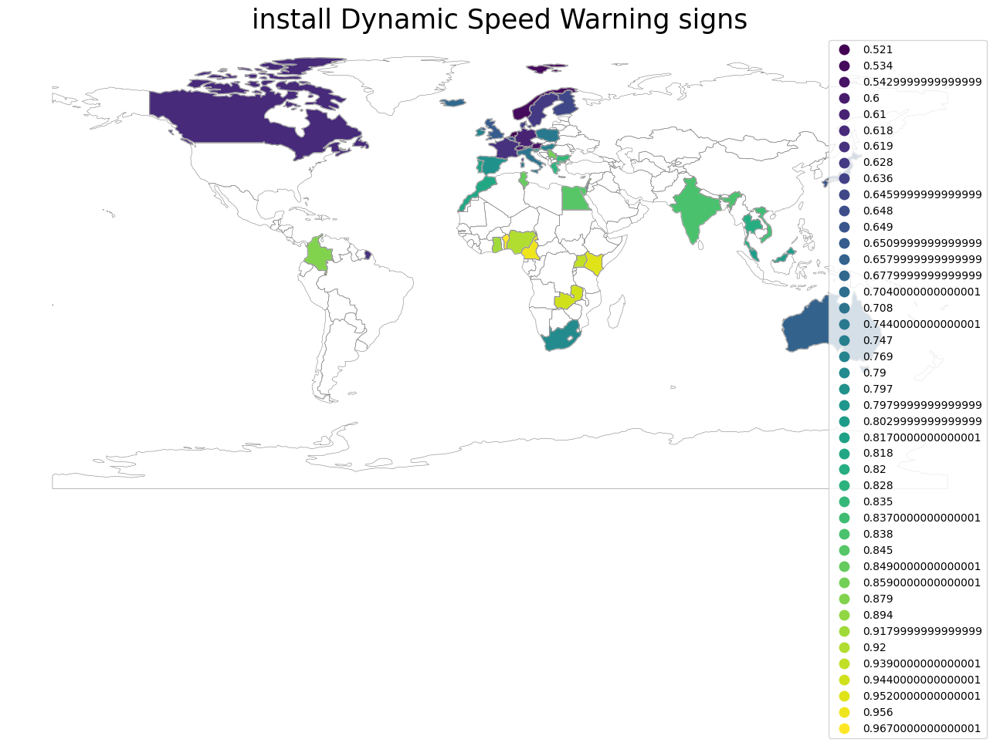

...

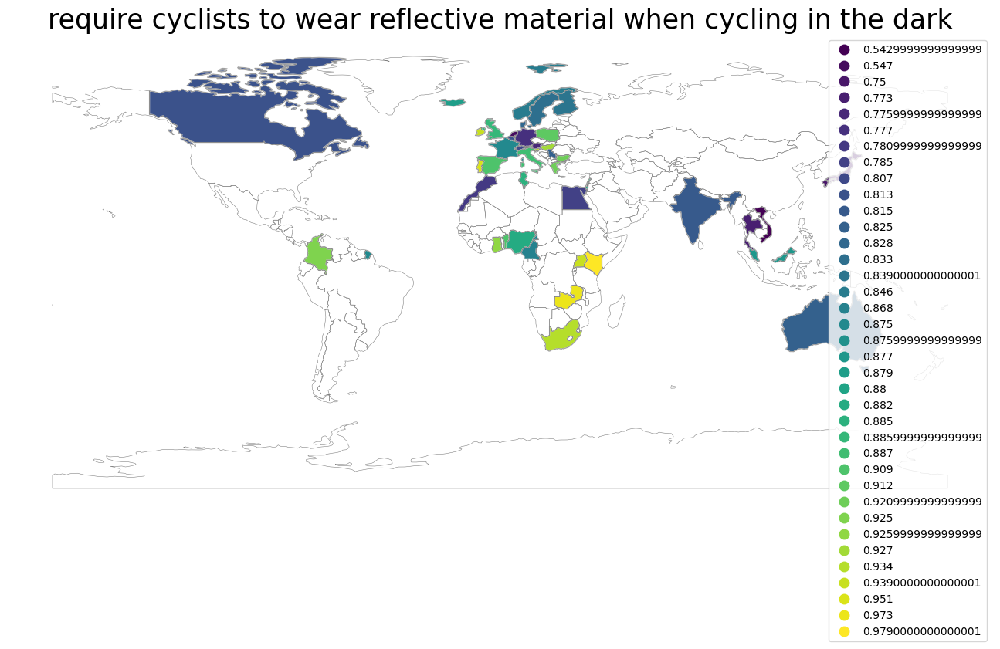

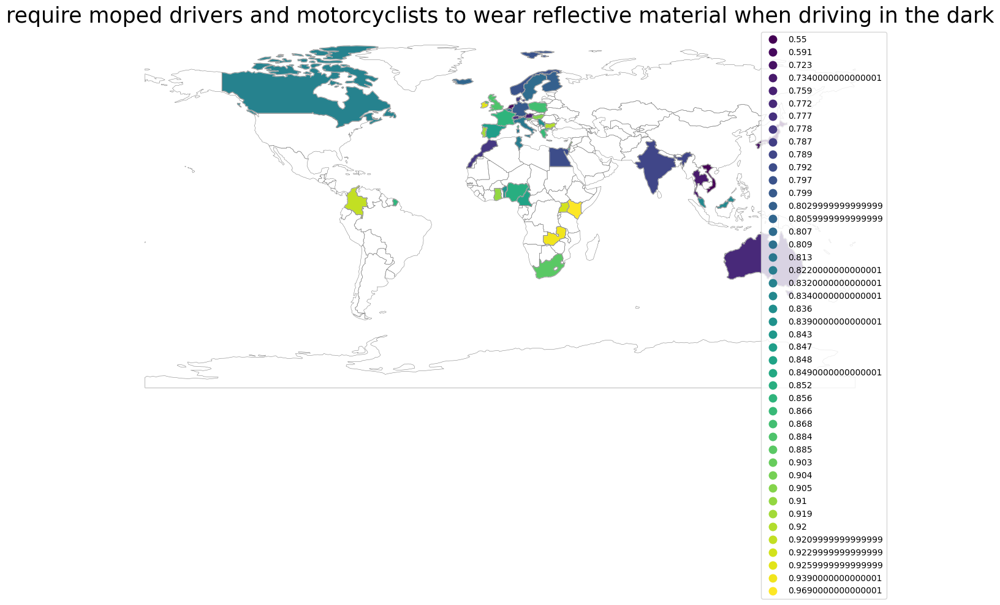

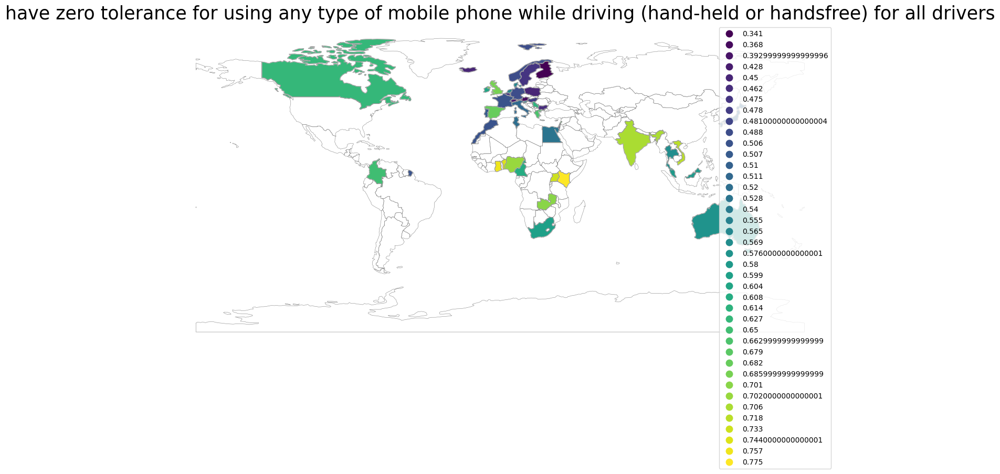

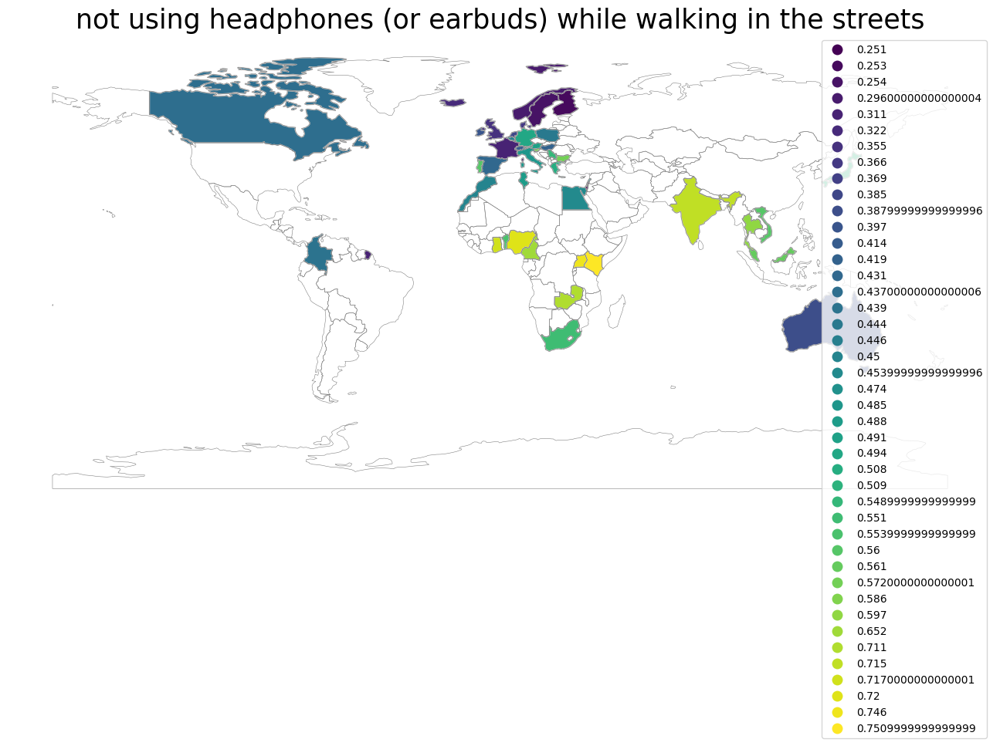

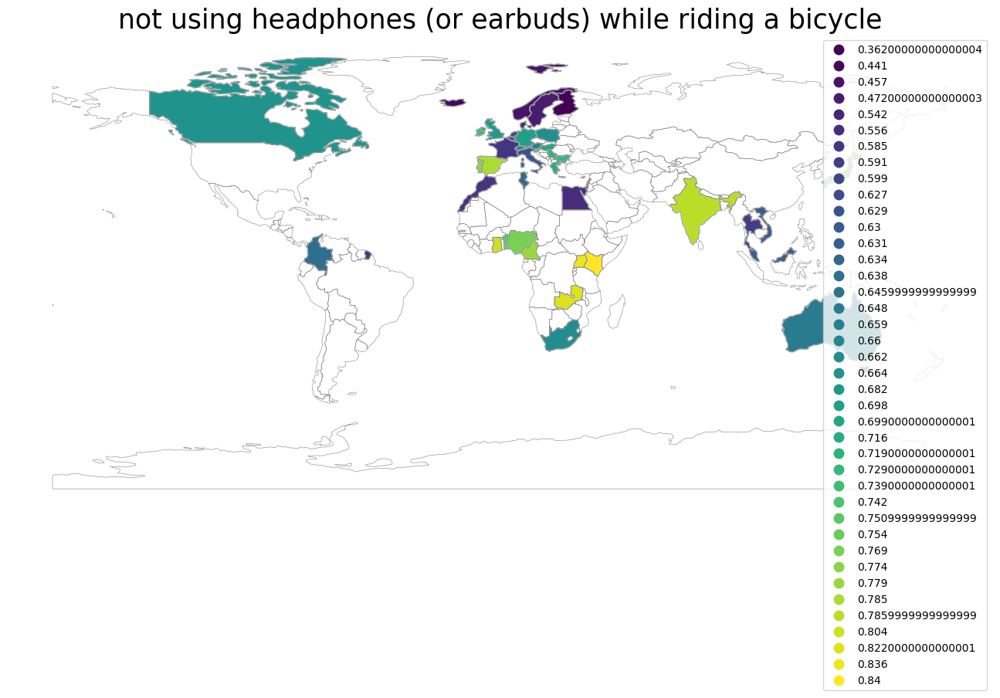

In [108]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data, free_legend=True)

### Vehicle automation (Q24/Q25)
Table 16: Interest in automated vehicles, by country and region (“How interested would you be in using
the following types of automated passenger car?” – % of interested – scores 5 to 7 on a 7-point scale
from 1 “not at all interested” to 7 “very interested”).

In [109]:
data = pd.read_excel(file,sheet_name=11)
data.rename(columns={"Column2" : "Country", "Column3" : "Semi-automated passenger car", "Column4" : "Fully-automated passenger car"}, inplace=True)
data = data.drop([0])
data = data.reset_index(drop=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/vehicle_automation.csv')
data

,Country,Semi-automated passenger car,Fully-automated passenger car
0,Australia,0.374,0.326
1,Austria,0.368,0.288
2,Belgium,0.394,0.293
3,Benin,0.624,0.343
4,Bulgaria,0.537,0.495
5,Cameroon,0.647,0.564
6,Canada,0.398,0.318
7,Colombia,0.592,0.566
8,Czech Republic,0.364,0.333
9,Denmark,0.392,0.294


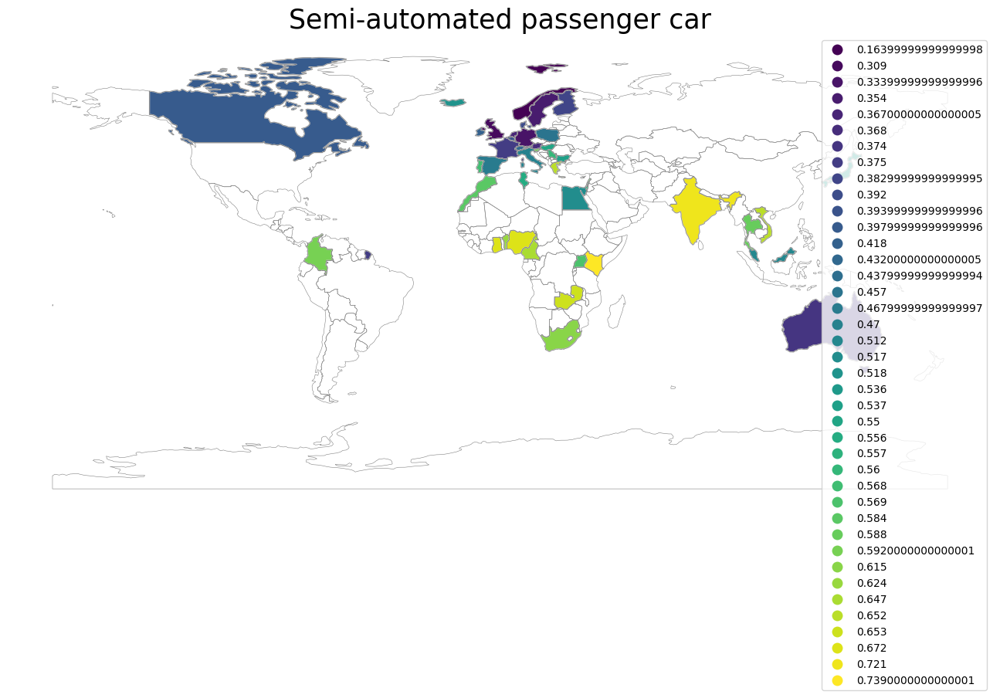

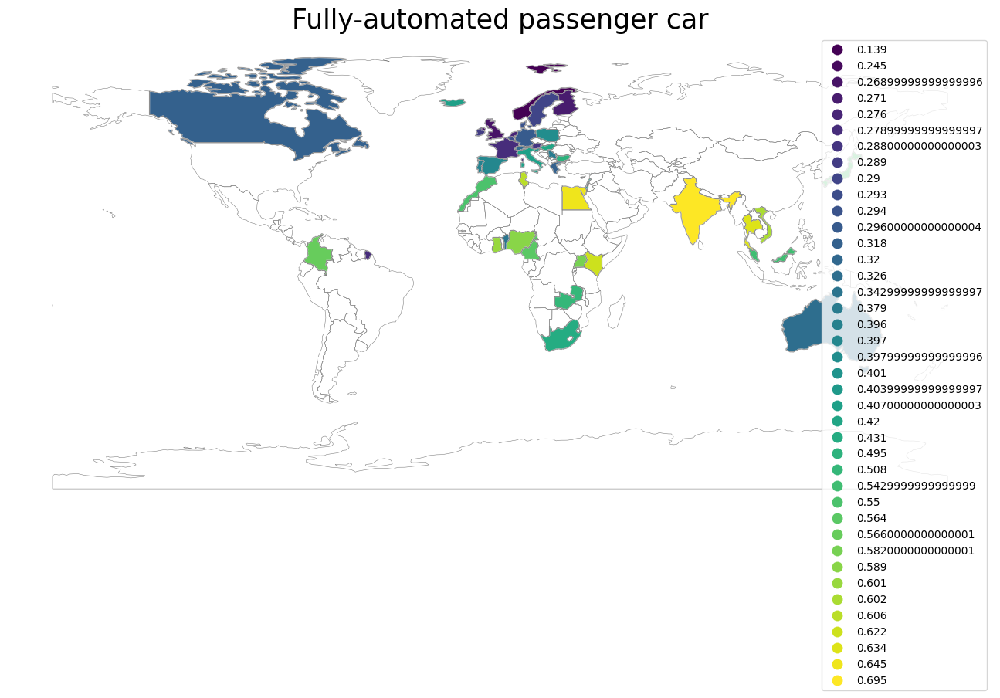

In [110]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data, free_legend=True)